# Follow the Best Price (FBP)

initialization $P_1$ &larr;  $\frac{1}{2}$

**for t=1,2.... do:**
    
   &emsp;post price $P_t$;
    
   &emsp;receive feedback ($S_t, B_t$)
    
   &emsp;pick $P_{t+1} \in argmax_{p \in [0,1]}\frac{1}{t}\sum_{i=1}^t {GFT(p, S_i, B_i)}$
    
**end**

guarda questo https://arxiv.org/pdf/2310.12107 per regret $\sqrt{T}$

### IMPORT LIBRERIE

In [97]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as st
import math
import pandas as pd
import os
%run distributions.ipynb

### DEFINIZIONE GFT

In [4]:
def gft(p, s, b): #gft(prezzo, prezzo seller, prezzo buyer)
    return np.round((b-s),num_cifre) if ((s <= p) & (p <= b)) else 0 #return (b-s) * I(s <= p <= b)

In [6]:
#se c'è un valore nan oppure 0 allora torna true
def check_nan(distr):
    if(np.isnan(distr).any()): return True
    if(not any(distr)): return True
    return False

# Versione 3

Andiamo a verificare i valori dei best price precedenti.

Noi sappiamo che il best price iniziale è 0.5.

Immaginiamo di essere al t-esimo round e di dover trovare il best price del round t+1.

Andiamo a controllare il GFT del round attuale. Se questo è pari a 0, allora andiamo a utilizzare uno dei best price precedenti e osserviamo il risultato.

In [9]:
#dato l'insieme dei prezzi migliori trovati fino ad adesso, restituisce 1 se almeno una delle somme dei gft(best_price, s, b)
#è diversa da 0

def checkSumValueBestPrices(best_prices, s, b):
    for best_price in best_prices:
        if(gft(best_price, s, b) != 0): return 1
    return 0

In [11]:
#preso un insieme di prezzi restituisce quello la cui somma dei gft risulta 
#essere maggiore tra tutte e restitusce anche questa

def get_best_price_and_max_sum(prices, t, S, B):
    values_tot_sum = []  # Lista per memorizzare i guadagni totali per ogni prezzo

    # Calcoliamo i guadagni totali per ogni prezzo una sola volta
    for p in prices:
        sum_gft_p = sum(gft(p, S[i], B[i]) for i in range(t))
        values_tot_sum.append(sum_gft_p)

    max_sum = max(values_tot_sum)
    best_p = prices[values_tot_sum.index(max_sum)]

    return best_p, max_sum if not type(max_sum) is list else max_sum[0]

In [13]:
#findBestPrice(valori seller, valori buyer, valore somma massima, #round, prezzo massimo iniziale, array di prezzi,cifre dopo la virgola, lista vuota GFT da riempire)
#restituisce il prezzo che massimizza la somma e il valore di questa

#CASI:

#1)
#Nel caso in cui gft(p,S_t,B_t) fosse 0, poichè B_t < S_t, allora sappiamo che non esiste 
#prezzo che possa far cambiare il valore di gft perciò ha senso considerare il prezzo migliore come quello attuale 
#e lo stesso vale per la somma (in quanto sommerremo per 0).

#2)
#Nel caso in cui gft(p,S_t,B_t) fosse > 0, allora, dal momento che stiamo considerando il prezzo migliore trovato fino ad ora,
#ovvero quello tale per cui la sommatoria risulta essere massima, andiamo a restituire questo come milgior prezzo; dal momento che
#il valore (B_t - S_t) non è influenzato dal valore di p, a patto che questo sia compreso tra S_t <= p <= B_t, e la somma 
#restituita sarà pari a quella ottenuta fino ad ora + il valore di gft(p,S_t,B_t).

#3)
#Nel caso in cui gft(p,S_t,B_t) fosse 0, ma il valore del buyer è >= del valore del seller, allora andiamo a calcolare il valore
#della somma dei gft(p,S_t,B_t) andando a considerare tutti i prezzi migliori ottenuti fino ad adesso.
#In questo modo non è necessario andare ad eseguire una ricerca lineare (troppo costosa computazionalmente).
#Se il valore gft(p,S_t,B_t) fosse 0 per ciascuno dei prezzi utilizzati in precedenza, allora andiamo a considerare il prezzo
#migliore p all'interno dell'intervallo [seller, buyer] che massimizza la somma di gft considerando i prezzi (buyer, seller)
#passati.
#Fatto ciò, andiamo a calcolare il prezzo che massimizza la somma del valore gft con (seller, buyer) passati tenendo anche conto del
#nuovo prezzo trovato.


def findBestPrice3(S,B,max_sum,t,p,best_prices,num_cifre,gft_list):

    best_p = p      #miglior prezzo fino ad ora trovato (0.5 nel round iniziale)
    min_price_found, max_price_found = 0,0
    
    gft_best_p = gft(best_p, S[t-1], B[t-1]) #gft con prezzo migliore fino ad ora trovato
    
    if(gft_best_p == 0): #se il valore è 0 abbiamo due possibilità
        if(S[t-1] > B[t-1]):      #possibilità 1 -> seller > buyer 
            gft_list.append(0)
            return best_p, max_sum                        #restituiamo il prezzo migliore come l'ultimo prezzo trovato e la somma massima come la somma massima trovata
        
        
        else:                                  #possibilità 2 -> o seller > p oppure p > buyer
                                               #nel caso in cui il gft sia 0 per ogni prezzo trovato
                                               #ad esempio nel primo round abbiamo s = 0,2 ; b = 0,3 ; p = {0,1; 0,4; 0,7} 

            max_val = checkSumValueBestPrices(best_prices, S[t-1], B[t-1])
            if(max_val == 0):
                #prendiamo ogni prezzo nell'intervallo [seller, buyer] e andiamo ad utilizzarlo come p per ogni 
                #(seller, buyer) fino ad ora ottenuto
                
                if(S[t-1] == B[t-1]):
                    best_prices.append(S[t-1])
                else:
                    #crea lista con prezzi all'interno di intervallo [seller, buyer]
                    prices = np.arange(
                        S[t-1],
                        B[t-1],
                        1/math.pow(10,num_cifre)
                    ).tolist()
                    
                    best_p, _ = get_best_price_and_max_sum(prices, t, S, B)
                    best_prices.append(best_p)
            
            #nel caso in cui almeno uno dei prezzi migliori sia compreso tra seller e buyer
            best_p, max_sum = get_best_price_and_max_sum(best_prices, t, S, B)
            gft_list.append(gft(best_p, S[t-1], B[t-1]))
            return best_p, max_sum
    
    #nel caso in cui il gft sia > 0
    #perchè sappiamo che il valore di gft non dipende dal prezzo se questo è compreso tra seller e buyer
    gft_list.append(gft_best_p)
    return best_p, (max_sum + gft_best_p)

In [15]:
#calcolo GFT per ogni valore S e B avendo come prezzo p = 0.5 sempre
def findBestPrice3ForMaxRegret(S,B,t):
    p = 0.5
    gft_list_maxR = []
    for i in range(1,t):
        val = gft(p, S[i], B[i])
        gft_list_maxR.append(val)
        
    return gft_list_maxR

In [17]:
#resituisce il prezzo che massimizza 1/t * somma GFT

def argmax3(t,S,B,p,best_prices,max_sum,num_cifre,gft_list):
    
    best_p,max_sum = findBestPrice3(S,B,max_sum,t,p,best_prices,num_cifre,gft_list)
    return best_p, max_sum #return 𝑎𝑟𝑔𝑚𝑎𝑥


In [19]:
#post round, price, Feedback, next best price, mean gain from trade

def print_all(t, p, s, b, best_p_found, mean_gft):
    print("\nRound: #",t)
    print("t-esimo Prezzo P: ", p, "\nt-esimo Prezzo Seller: ", s, "\nt-esimo Prezzo Buyer: ", b)
    print("il massimo guadagno medio è: ", mean_gft * (1/t))
    print('t+1-esimo prezzo P:', best_p_found)

In [21]:
def FBP(S,B, num_round,num_cifre):
    t = 1
    p = 0.5
    best_prices = [p] #lista di tutti i prezzi migliori fino ad ora trovati
    max_mean_gft = 0 # valore massimo somma per prezzo migliore
    
    map_prices_max_sum = {} #dizionario {prezzo migliore-max media somma gft associato a quel prezzo}
    list_prices_graph = [] #lista dei prezzi migliori (per fare grafico)
    list_mean_sum_gft_graph = [] #lista media somma gft per (per fare grafico)
    
    gft_list = [] #lista contenente il gain from trade di ogni round t
    
    while (t <= num_round):

        best_p_found, best_p_found_mean_gft = argmax3(t, S, B, p, best_prices, max_mean_gft, num_cifre, gft_list) #pick P_{t+1}
        
        print_all(t, p, S[t-1], B[t-1], best_p_found, best_p_found_mean_gft) #restituisce i valori trovati in questo round
        
        p = best_p_found #associamo a P_{t+1} il miglior prezzo trovato a questo round
        max_mean_gft = best_p_found_mean_gft #associamo al max valore della somma media gft quello trovato in questo round
        t += 1 #next round
        best_prices.append(p) #inserisci nuovo miglior prezzo trovato nella lista
        
        map_prices_max_sum.update({p: max_mean_gft})
        list_prices_graph.append(p)
        list_mean_sum_gft_graph.append(max_mean_gft)
        
    print('\nPrezzo migliore finale: ', best_p_found, "\nValore media somma gft associato: ", max_mean_gft * (1/t))
    print(len(gft_list))
    return map_prices_max_sum, list_prices_graph, list_mean_sum_gft_graph, best_p_found, gft_list

## GRAFICI

In [24]:
#effettua grafici: scatter plot(x,y), istogramma(x), istogramma(y), istogramma(gft)
#con best_prices = lista dei prezzi migliori ad ogni round
#con max_sum_round = lista della somma che max gft ad ogni round
#con dict_prices_sum = mappa con chiave prezzo e valore max sum di gft
#con i = turno attuale
def draw_graph(best_prices,max_sum_round,dict_prices_sum, gft_list,i):
    
    best_prices = np.array(best_prices)
    max_sum_round = np.array(max_sum_round)
    
    fig, axs = plt.subplots(2,2,figsize = (10,10),constrained_layout = True)

    #istogramma prezzi
    axs[0][0].set_title("Istogramma prezzi migliori")
    axs[0][0].set_xlabel("Prezzo migliore")
    axs[0][0].hist(best_prices, bins = 25)
    
    #istogramma somma media
    axs[0][1].set_title("Istogramma media somma migliori")
    axs[0][1].set_ylabel("Media Somma GFT(p, Si, Bi)")
    axs[0][1].hist(max_sum_round, bins = 25)
    
    #scatter plot
    sorted(dict_prices_sum)
    axs[1][0].set_title("Relazione best_p-max_mean_gft")
    x = np.array(list(dict_prices_sum.keys()))
    y = np.array(list(dict_prices_sum.values()))
    axs[1][0].vlines(x,0,y)
    axs[1][0].set_xlabel("Prezzo migliore")
    axs[1][0].set_ylabel("Media Somma GFT(p, Si, Bi)")
    
    #grafico gft
    axs[1][1].hist(gft_list)
    axs[1][1].set_title("Grafico gft")
    axs[1][1].set_xlabel("gft")
    
    #fig.tight_layout()
    supt = "Turno: " + str(i+1)
    
    fig.suptitle(supt)


### DISTRIBUZIONE UNIFORME

In [27]:
#grafico regret con grafico square(T) con somma GFT e regret calcolato come:
#Regret = T * regret atteso massimo - somma reward ottenuti -> dovrebbe crescere come radice di T
#il valore attesso massimo è 1/8 nel caso di distribuzione uniforme
def draw_regret_squareT3(gft_list):
    fig, axs = plt.subplots(1,3, figsize = (15,5))
    num_round = len(gft_list)
    regret_list = list(1/8 * i for i in range(1,num_round))
    values = [sum(gft_list[:i]) for i in range(1, num_round)]
    values_regret = np.subtract(values,regret_list)
    

    fig.suptitle("Grafici Regret", fontsize = 15)
    
    a = values_regret
    b = np.array(list(map(math.sqrt, np.arange(1,num_round))))
    
        
    axs[0].plot(np.arange(1,num_round), values)
    axs[0].set_ylabel("Sum GFT")
    axs[0].set_xlabel("t") #dove t rappresenta il numero di round eseguiti
    
    axs[1].plot(np.arange(1,num_round), regret_list)
    axs[1].set_ylabel("MAX Regret")
    axs[1].set_xlabel("t") #dove t rappresenta il numero di round eseguiti
    
    axs[2].plot(np.arange(1,num_round),a,label = "Sum GFT")
    axs[2].plot(np.arange(1,num_round),b, label = "$\sqrt{T}$")
    axs[2].legend(loc="upper left")
    axs[2].set_ylabel("Value")
    axs[2].set_xlabel("t") #dove t rappresenta il numero di round eseguiti



### DISTRIBUZIONE BETA

In [30]:
#grafico regret con grafico square(T) con somma GFT e regret calcolato come:
#Regret = T * regret atteso massimo - somma reward ottenuti -> dovrebbe crescere come radice di T
def draw_regret_squareT3_beta(gft_list, alpha_S, beta_S ,alpha_B, beta_B):
    fig, axs = plt.subplots(1,3, figsize = (15,5))
    num_round = len(gft_list)
    
    #0.5 = p possibile per regret ottimale
    regret_list = list(expected_value_beta(alpha_S, beta_S ,alpha_B, beta_B , 0.5, i ) for i in range(1, num_round))
    values = [sum(gft_list[:i]) for i in range(1, num_round)]
    values_regret = np.subtract(regret_list,values)
    

    fig.suptitle("Grafici Regret", fontsize = 15)
    
    a = values_regret
    b = np.array(list(map(math.sqrt, np.arange(1,num_round))))
    
        
    axs[0].plot(np.arange(1,num_round), values)
    axs[0].set_ylabel("Sum GFT")
    axs[0].set_xlabel("t") #dove t rappresenta il numero di round eseguiti
    
    axs[1].plot(np.arange(1,num_round), regret_list)
    axs[1].set_ylabel("MAX Regret")
    axs[1].set_xlabel("t") #dove t rappresenta il numero di round eseguiti
    
    axs[2].plot(np.arange(1,num_round),a,label = "Sum GFT")
    axs[2].plot(np.arange(1,num_round),b, label = "$\sqrt{T}$")
    axs[2].legend(loc="upper left")
    axs[2].set_ylabel("Value")
    axs[2].set_xlabel("t") #dove t rappresenta il numero di round eseguiti




## Distribuzione D± $\epsilon$

Distribuzione del buyer: $f_{S, \pm\epsilon} = 2(1\pm\epsilon) * I[0, \frac{1}{4}] + 2(1\mp\epsilon) * I[\frac{1}{2}, \frac{3}{4}]$

Distribuzione del seller: $f_{B} = 2 * (I[\frac{1}{4}, \frac{1}{2}] \cup I[\frac{3}{4}, 1])$

In [33]:
import numpy as np
from scipy.integrate import dblquad
from scipy.integrate import nquad

def expected_value_epsilon(p, epsilon):
    # Funzione di densità del seller
    def seller_pdf(s, epsilon):
        if 0 <= s <= 1/4:
            return  (1 + epsilon)
        elif 1/2 <= s <= 3/4:
            return  (1 - epsilon)
        else:
            return 0

    # Funzione di densità del buyer
    def buyer_pdf(b):
        if 1/4 <= b <= 1/2 or 3/4 <= b <= 1:
            return 1
        else:
            return 0

    # Funzione integranda
    def integrand(b, s, epsilon):
        return (b - s) * (seller_pdf(s, epsilon) + buyer_pdf(b))
    
    # Split the integration into manageable ranges to handle discontinuities
    def integrate_over_range():
        options = {'epsabs': 1e-8, 'epsrel': 1e-6, 'limit': 1000}
        results = []
        
        # Define ranges that avoid the discontinuities
        ranges = [
            [[p, 1], [0, 1/4]],
            [[p, 1], [1/4, 1/2]],
            [[p, 1], [1/2, 3/4]],
            [[p, 1], [3/4, p]]
        ]
        
        for r in ranges:
            result, error = nquad(integrand, r, args=(epsilon,), opts=[options, options])
            results.append(result)
        
        return sum(results)
    
    # Calculate and return the result
    result = integrate_over_range()
    return result * 4


In [35]:
#grafico regret con grafico square(T) con somma GFT e regret calcolato come:
#Regret = T * regret atteso massimo - somma reward ottenuti -> dovrebbe crescere come radice di T
def draw_regret_squareT3_DEpsilon(gft_list, epsilon):
    fig, axs = plt.subplots(1,3, figsize = (15,5))
    num_round = len(gft_list)
    
    #0.5 = p possibile per regret ottimale
    regret_list = list(expected_value_epsilon(0.5, epsilon) for i in range(1, num_round))
    values = [sum(gft_list[:i]) for i in range(1, num_round)]
    values_regret = np.subtract(regret_list,values)
    

    fig.suptitle("Grafici Regret", fontsize = 15)
    
    a = values_regret
    b = np.array(list(map(math.sqrt, np.arange(1,num_round))))
    
        
    axs[0].plot(np.arange(1,num_round), values)
    axs[0].set_ylabel("Sum GFT")
    axs[0].set_xlabel("t") #dove t rappresenta il numero di round eseguiti
    
    axs[1].plot(np.arange(1,num_round), regret_list)
    axs[1].set_ylabel("MAX Regret")
    axs[1].set_xlabel("t") #dove t rappresenta il numero di round eseguiti
    
    axs[2].plot(np.arange(1,num_round),a,label = "Sum GFT")
    axs[2].plot(np.arange(1,num_round),b, label = "$\sqrt{T}$")
    axs[2].legend(loc="upper left")
    axs[2].set_ylabel("Value")
    axs[2].set_xlabel("t") #dove t rappresenta il numero di round eseguiti



## NUMERO ROUND DA ESEGUIRE NELL'ALGORITMO

In [38]:
num_round = int(input("Inserire numero di round: \n"))
while True:
    num_cifre = int(input("Inserire massimo numero di cifre dopo la virgola: \n"))
    if(num_cifre < 8): break

Inserire numero di round: 
 1500
Inserire massimo numero di cifre dopo la virgola: 
 2


## MEDIA DEL GFT

Creiamo il grafico della media del gft delle n esecuzioni.

In [178]:
#grafico regret con grafico square(T) con somma GFT e regret calcolato come:
#Regret = T * regret atteso massimo - somma reward ottenuti -> dovrebbe crescere come radice di T

def calculate_regret(gft_list,n,num_round):
    #il valore attesso massimo è 1/8 nel caso di distribuzione uniforme
    regret_list = list(1/8 * i for i in range(1,num_round))
    result = [0] * num_round
    #per ogni volta che abbiamo eseguito algoritmo
    for j in range(n):
        
        #somma valori gft del j-esimo round
        values = [sum(gft_list[j][:i]) for i in range(1, num_round)]
        #esegue la somma dei valori i e j nelle liste values e result e lo mette in result
        result = [i+k for i,k in zip(values,result)]

    median_result = [x / n for x in result]
    values_regret = np.subtract(regret_list,median_result)

    return values_regret,median_result


def draw_median_gft_graph(gft_list, n, num_round):

    values_regret, median_result= calculate_regret(gft_list,n,num_round)
    b = np.array(list(map(math.sqrt, np.arange(1,num_round))))

    plt.plot(np.arange(1,num_round),values_regret,label = "Sum GFT")
    plt.plot(np.arange(1,num_round),b, label = "$\sqrt{T}$")
    x = np.linspace(0, num_round,num_round )
    
    plt.legend(loc="upper left")


In [180]:
def draw_results(gft_list, num_round):
    values_regret, median_result= calculate_regret(gft_list,n,num_round)
    b = np.array(list(map(math.sqrt, np.arange(1,num_round))))
    
    f, (ax1, ax2) = plt.subplots(1, 2, sharey=True)
    ax1.plot(np.arange(1,num_round),median_result,label="Results", color = 'green')
    ax1.plot(np.arange(1,num_round),b, label = "$\sqrt{T}$", color = 'blue')
    ax1.set_title("$\sqrt{T}$")
    
    x = np.linspace(0, num_round,num_round)
    regret = [math.sqrt(num**3) for num in x]

    ax2.plot(np.arange(1,num_round),median_result,label="Results", color='green')
    ax2.plot(x, regret, label=r'$T^{\frac{2}{3}}$', color='blue', linewidth=2)
    ax2.set_title(r'$T^{\frac{2}{3}}$')

# NUMERO VOLTE ESECUZIONE ALGORITMO

In [44]:
n = int(input("Inserire numero di esecuzioni: "))

Inserire numero di esecuzioni:  10


### SCELTA TIPO DISTRIBUZIONE

### UNIFORME


Turno:  1

Round: # 1
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.75 
t-esimo Prezzo Buyer:  0.8
il massimo guadagno medio è:  0.05
t+1-esimo prezzo P: 0.75

Round: # 2
t-esimo Prezzo P:  0.75 
t-esimo Prezzo Seller:  0.73 
t-esimo Prezzo Buyer:  0.54
il massimo guadagno medio è:  0.025
t+1-esimo prezzo P: 0.75

Round: # 3
t-esimo Prezzo P:  0.75 
t-esimo Prezzo Seller:  0.4 
t-esimo Prezzo Buyer:  1.0
il massimo guadagno medio è:  0.21666666666666667
t+1-esimo prezzo P: 0.75

Round: # 4
t-esimo Prezzo P:  0.75 
t-esimo Prezzo Seller:  0.18 
t-esimo Prezzo Buyer:  0.2
il massimo guadagno medio è:  0.1625
t+1-esimo prezzo P: 0.75

Round: # 5
t-esimo Prezzo P:  0.75 
t-esimo Prezzo Seller:  0.21 
t-esimo Prezzo Buyer:  0.65
il massimo guadagno medio è:  0.20800000000000002
t+1-esimo prezzo P: 0.5

Round: # 6
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.53 
t-esimo Prezzo Buyer:  0.94
il massimo guadagno medio è:  0.17666666666666667
t+1-esimo prezzo P: 0.75

Round: # 7
t-esim

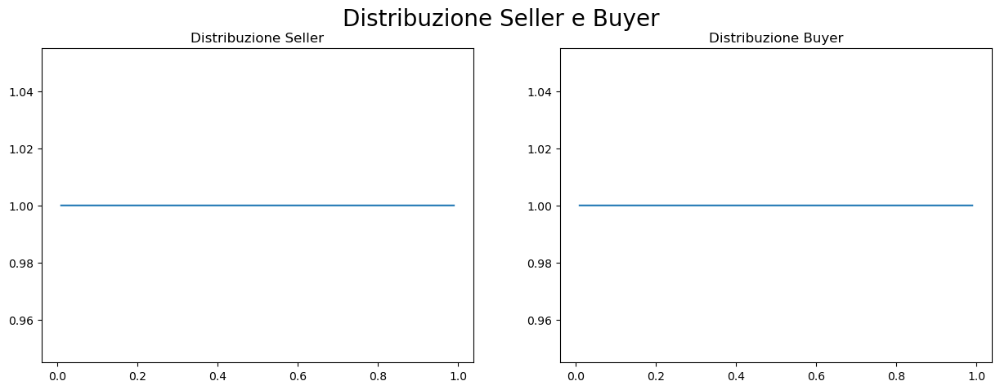

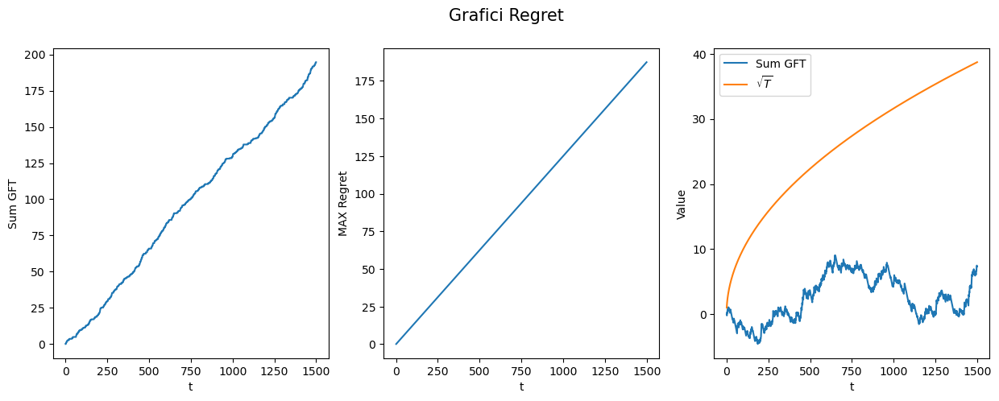

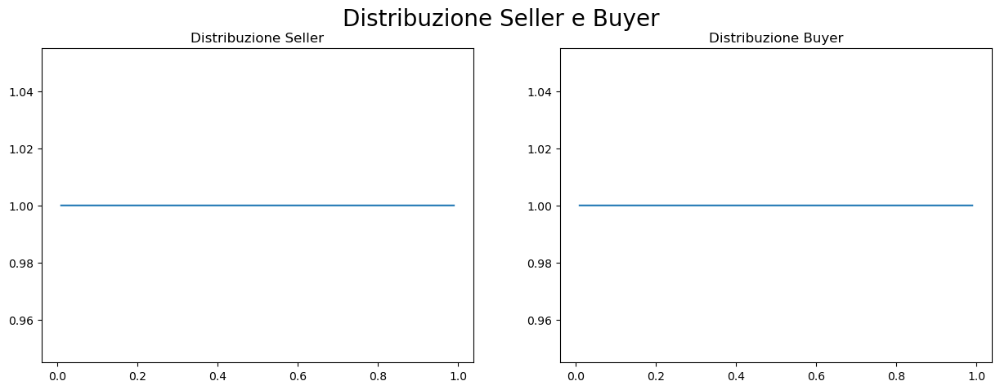

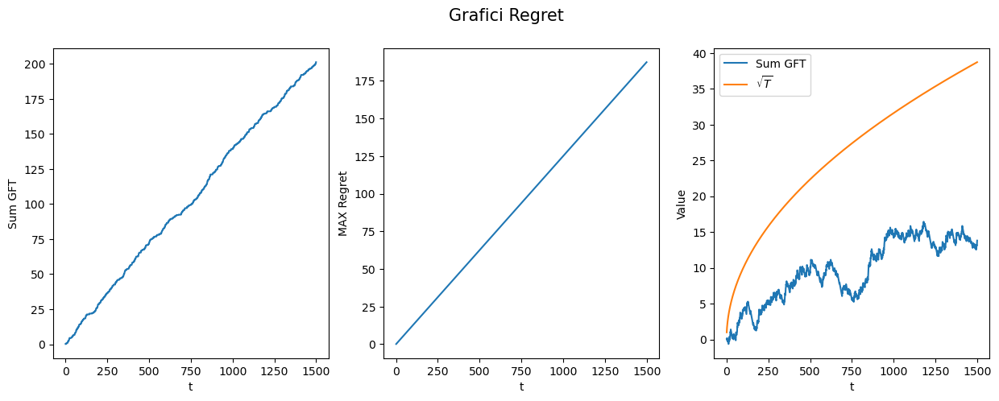

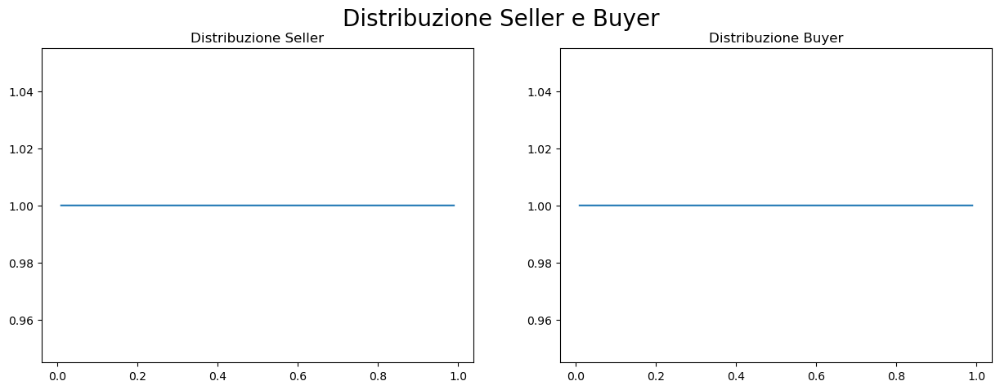

...

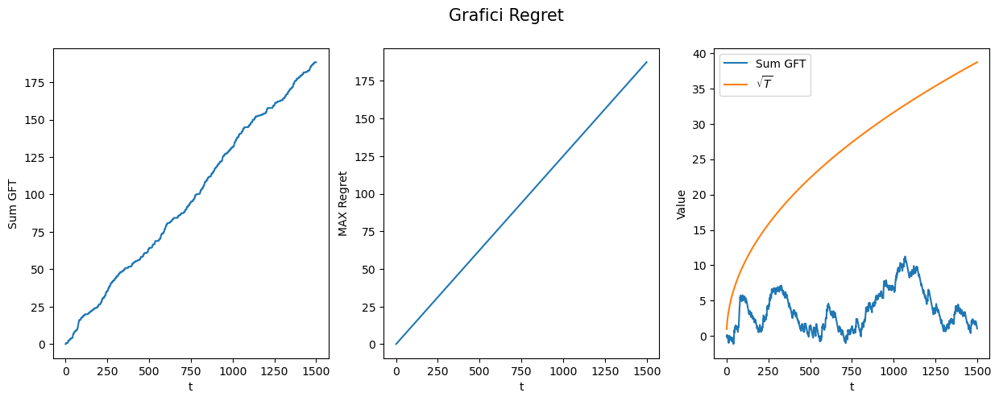

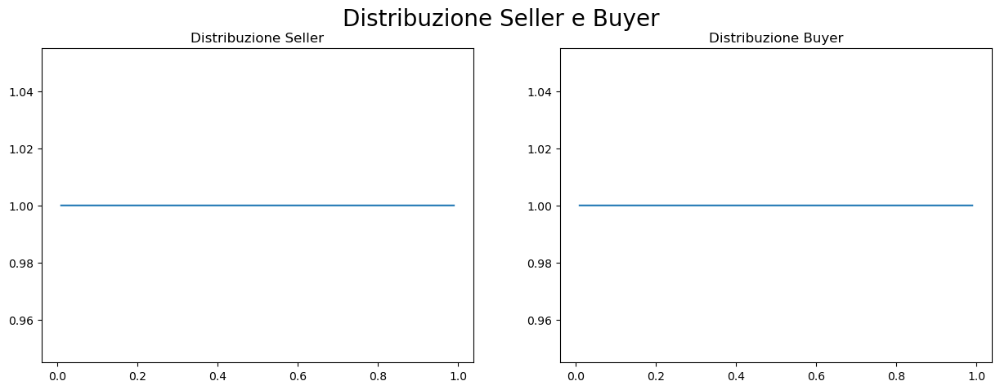

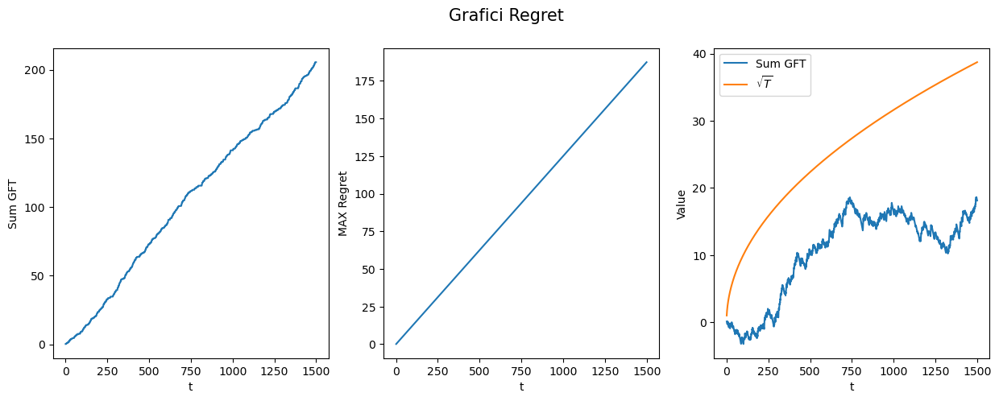

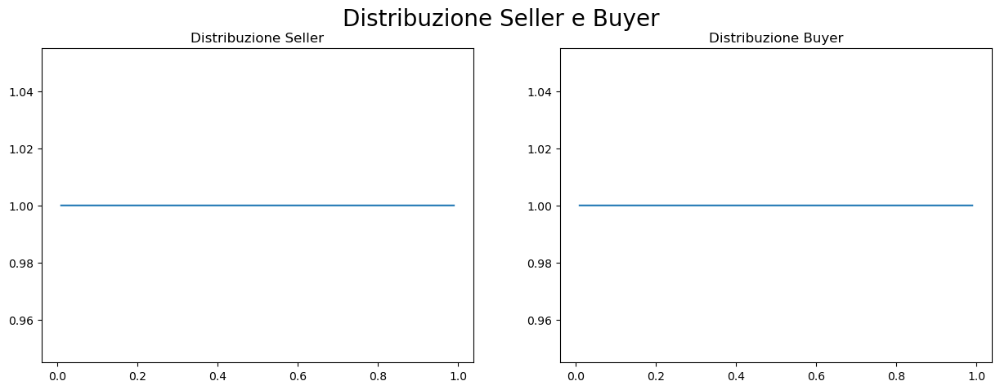

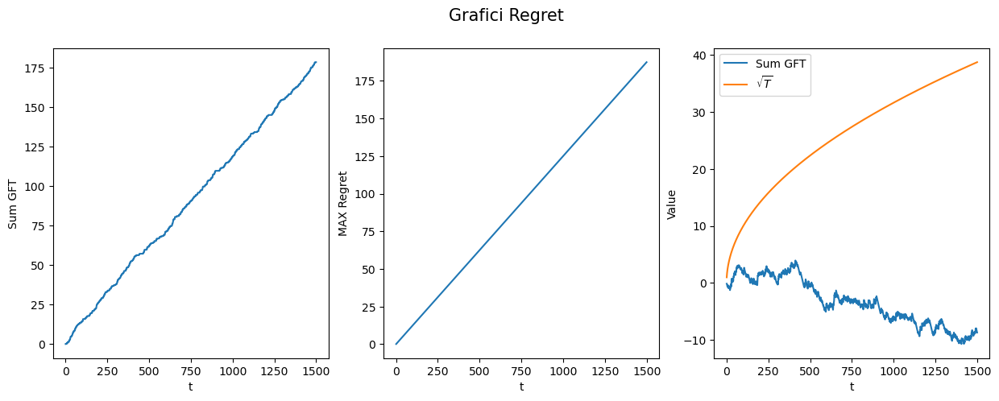

In [79]:
final_gft_results = check_stats_uniform(n, num_round, num_cifre)

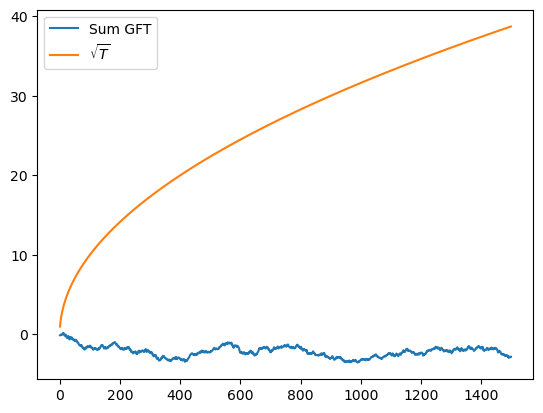

In [80]:
draw_median_gft_graph(final_gft_results, n, num_round)

### UNIFORME SPAZIATA CASUALE


Turno:  1
Estremi Seller: [0,0.7]
Estremi Buyer: [0.8,1]

Round: # 1
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.41 
t-esimo Prezzo Buyer:  0.81
il massimo guadagno medio è:  0.4
t+1-esimo prezzo P: 0.5

Round: # 2
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.58 
t-esimo Prezzo Buyer:  0.95
il massimo guadagno medio è:  0.385
t+1-esimo prezzo P: 0.58

Round: # 3
t-esimo Prezzo P:  0.58 
t-esimo Prezzo Seller:  0.27 
t-esimo Prezzo Buyer:  0.96
il massimo guadagno medio è:  0.48666666666666664
t+1-esimo prezzo P: 0.58

Round: # 4
t-esimo Prezzo P:  0.58 
t-esimo Prezzo Seller:  0.16 
t-esimo Prezzo Buyer:  0.97
il massimo guadagno medio è:  0.5675
t+1-esimo prezzo P: 0.58

Round: # 5
t-esimo Prezzo P:  0.58 
t-esimo Prezzo Seller:  0.03 
t-esimo Prezzo Buyer:  0.85
il massimo guadagno medio è:  0.618
t+1-esimo prezzo P: 0.58

Round: # 6
t-esimo Prezzo P:  0.58 
t-esimo Prezzo Seller:  0.68 
t-esimo Prezzo Buyer:  0.88
il massimo guadagno medio è:  0.5483333333333333
t+1-esim

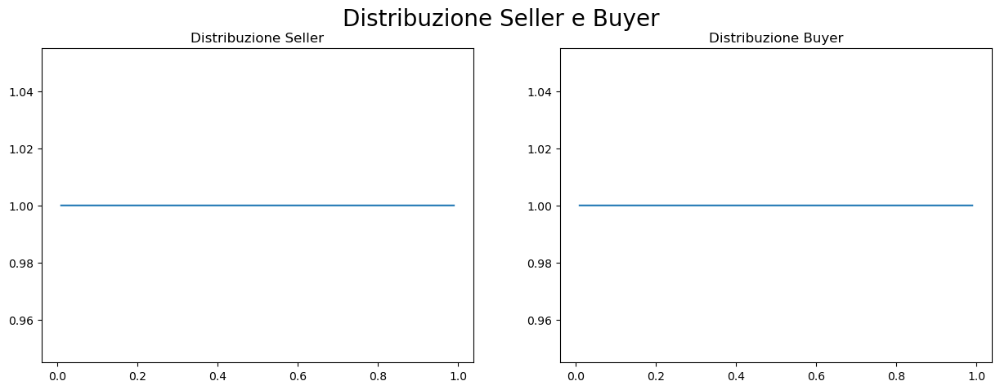

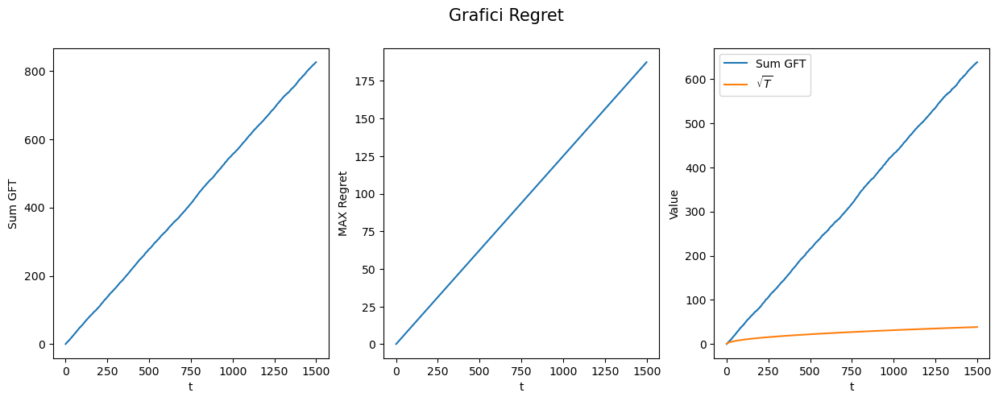

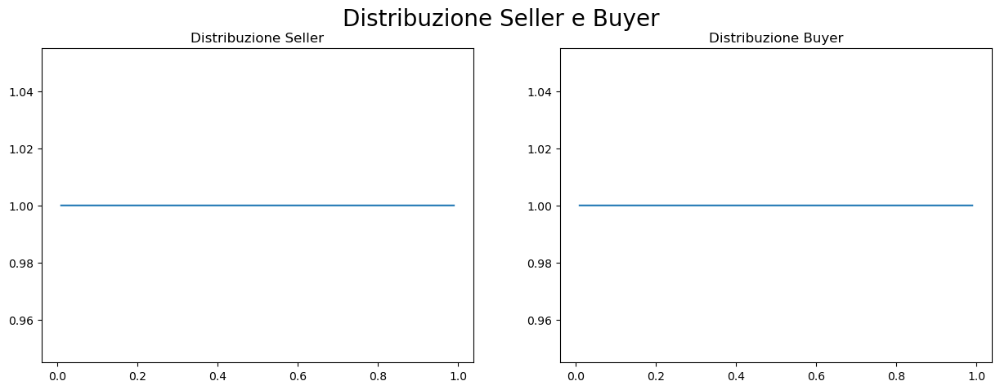

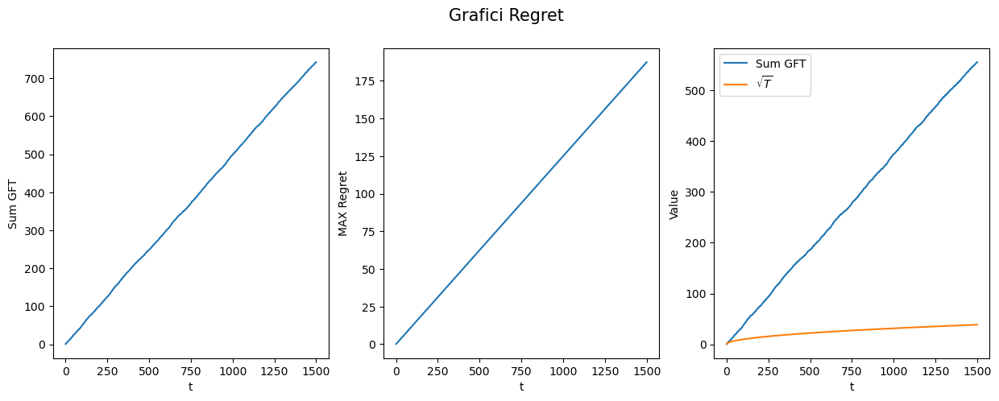

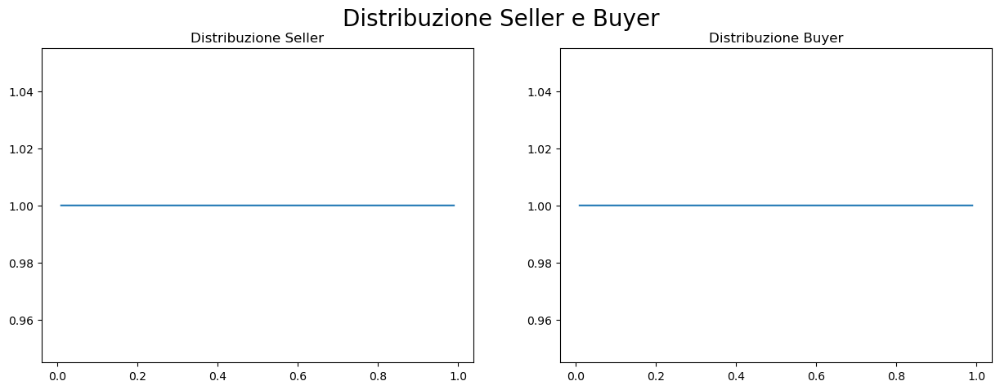

...

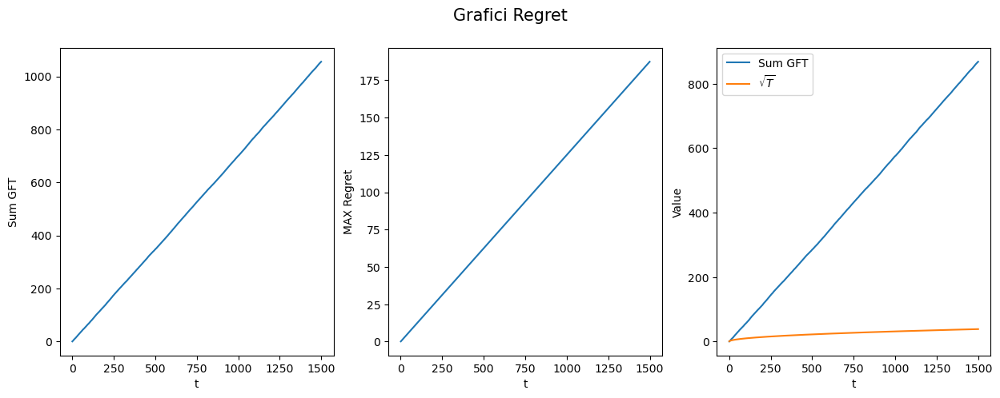

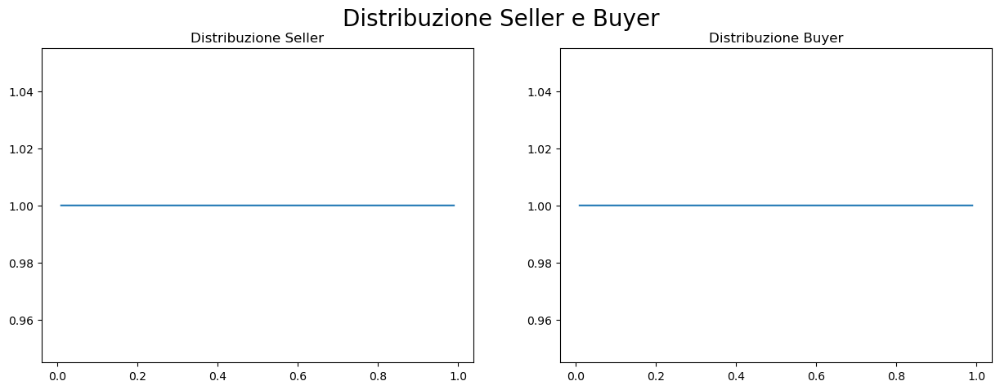

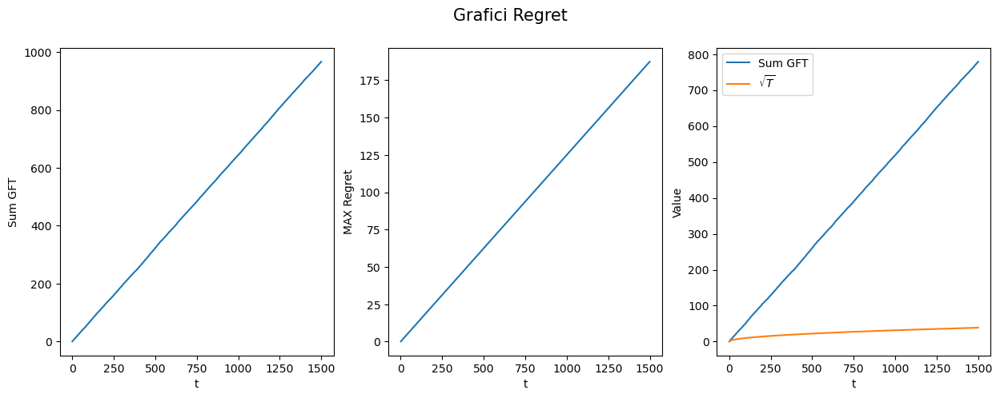

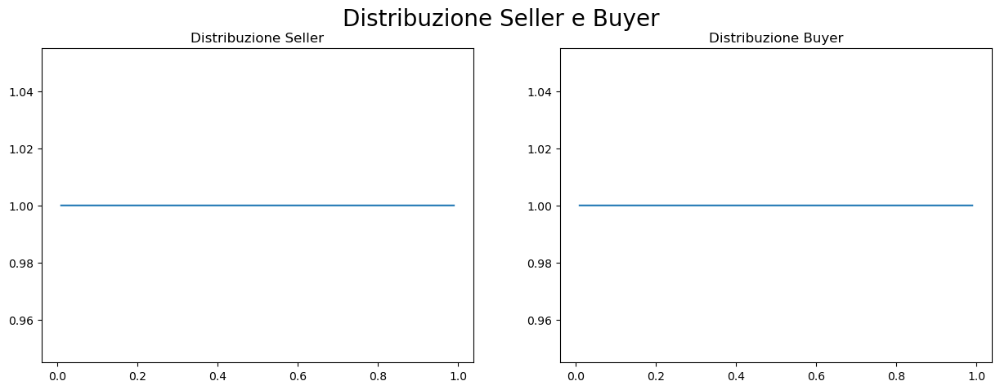

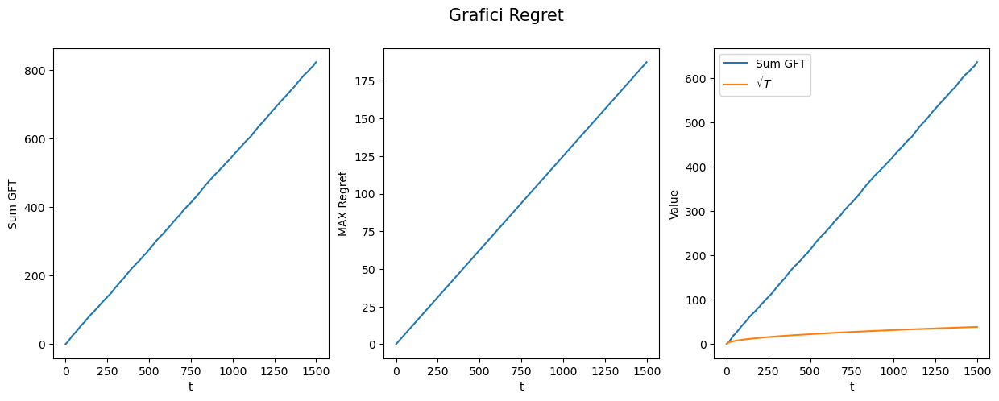

In [81]:
final_gft_results = check_stats_uniform_spaced(n, num_round, num_cifre)

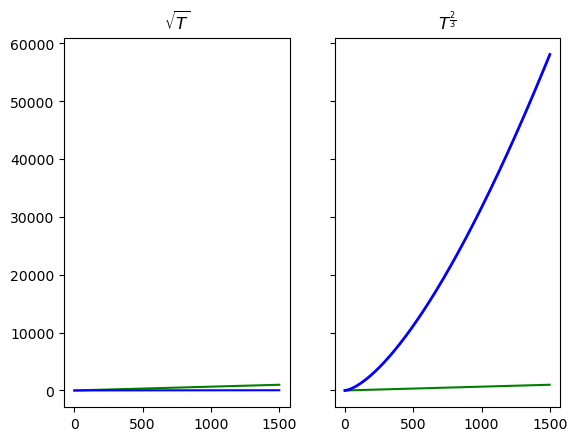

In [170]:
draw_results(final_gft_results, num_round)

In [83]:
rangeval = 0.3

### Variabile di Spaziata

In questo caso dato un valore casuale dell'estremo max del primo intervallo, definiamo un valore (rangeval) che rappresenta la distanza che l'estremo min del secondo intervallo deve avere dal primo.


Turno:  1
Estremi Seller: [0,0.2]
Estremi Buyer: [0.5,1]

Round: # 1
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.03 
t-esimo Prezzo Buyer:  0.79
il massimo guadagno medio è:  0.76
t+1-esimo prezzo P: 0.5

Round: # 2
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.01 
t-esimo Prezzo Buyer:  0.79
il massimo guadagno medio è:  0.77
t+1-esimo prezzo P: 0.5

Round: # 3
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.11 
t-esimo Prezzo Buyer:  0.55
il massimo guadagno medio è:  0.6599999999999999
t+1-esimo prezzo P: 0.5

Round: # 4
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.02 
t-esimo Prezzo Buyer:  0.95
il massimo guadagno medio è:  0.7275
t+1-esimo prezzo P: 0.5

Round: # 5
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.02 
t-esimo Prezzo Buyer:  0.93
il massimo guadagno medio è:  0.7640000000000001
t+1-esimo prezzo P: 0.5

Round: # 6
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.16 
t-esimo Prezzo Buyer:  0.71
il massimo guadagno medio è:  0.7283333333333333
t+1-

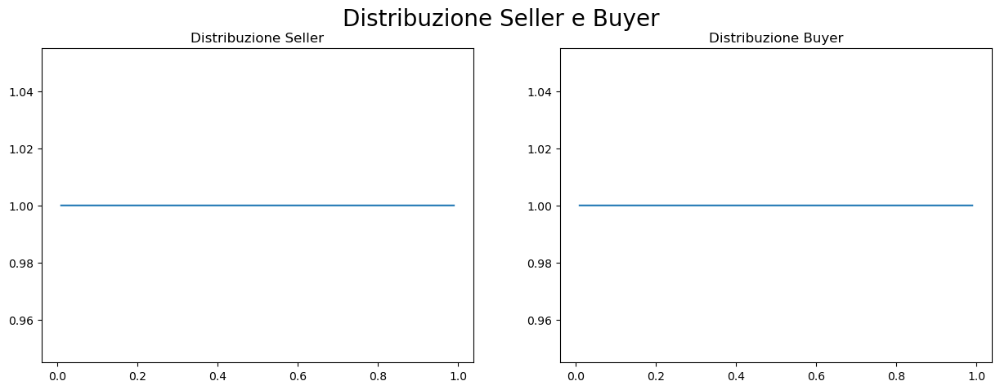

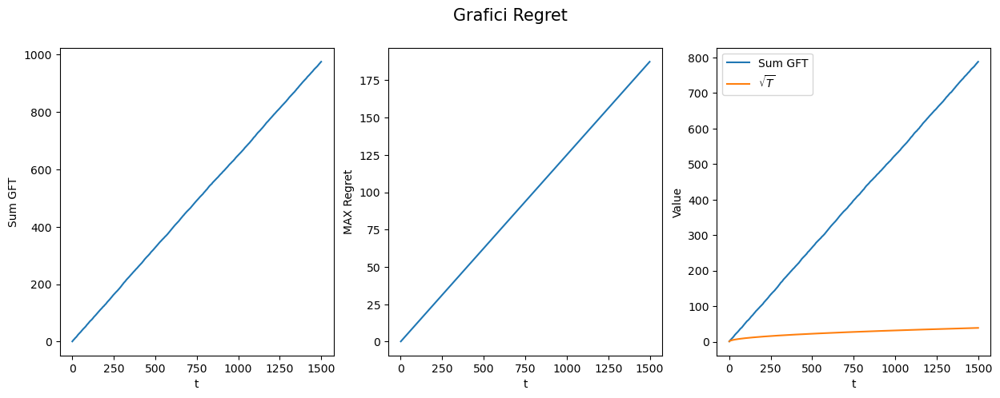

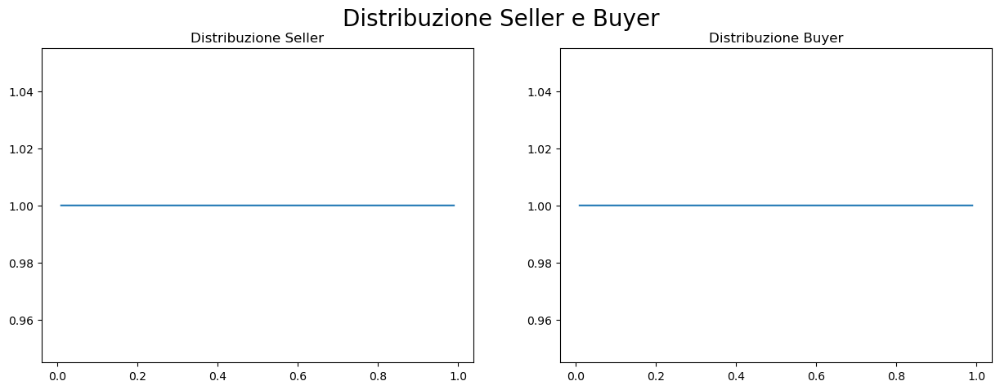

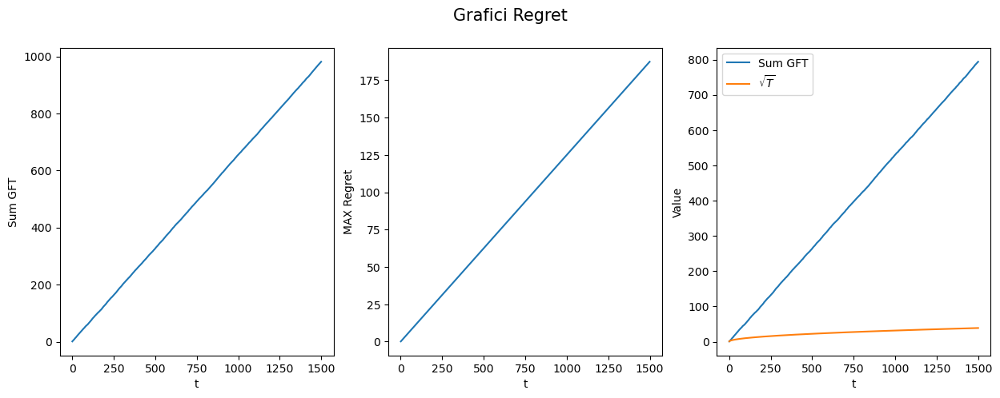

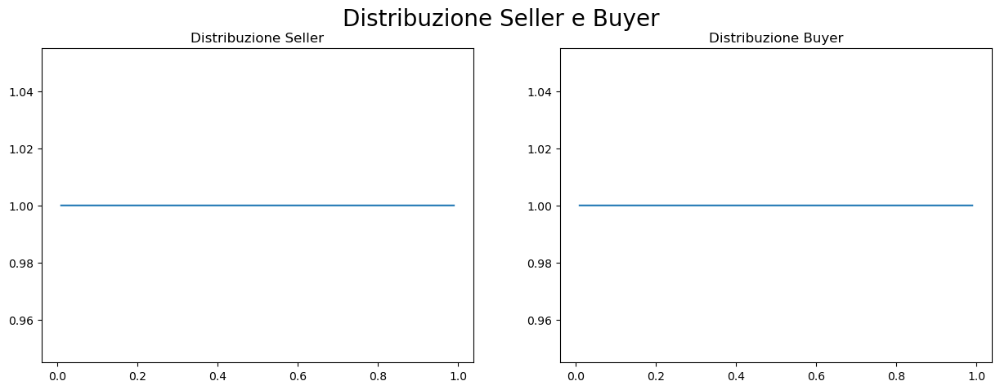

...

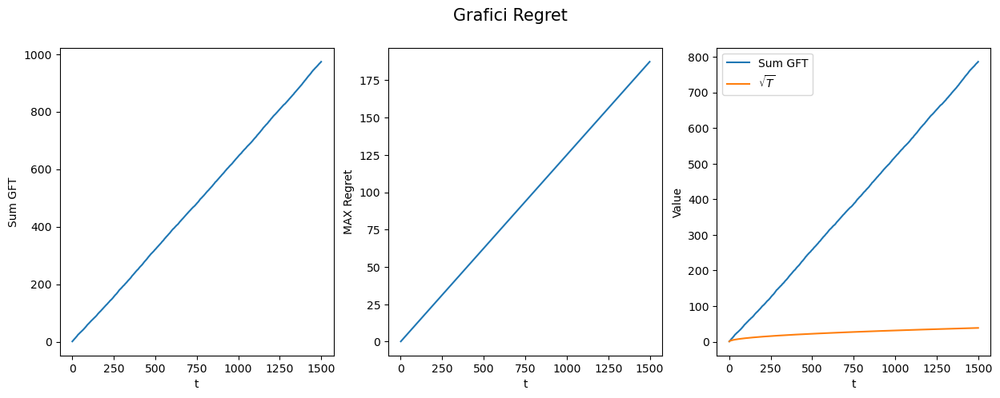

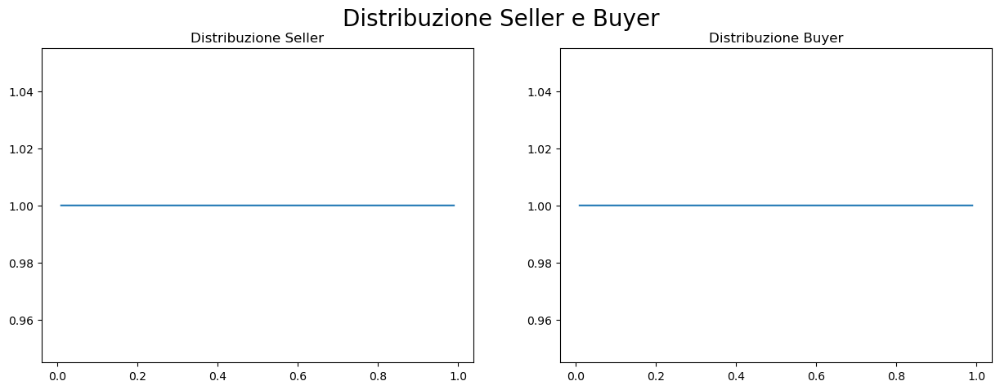

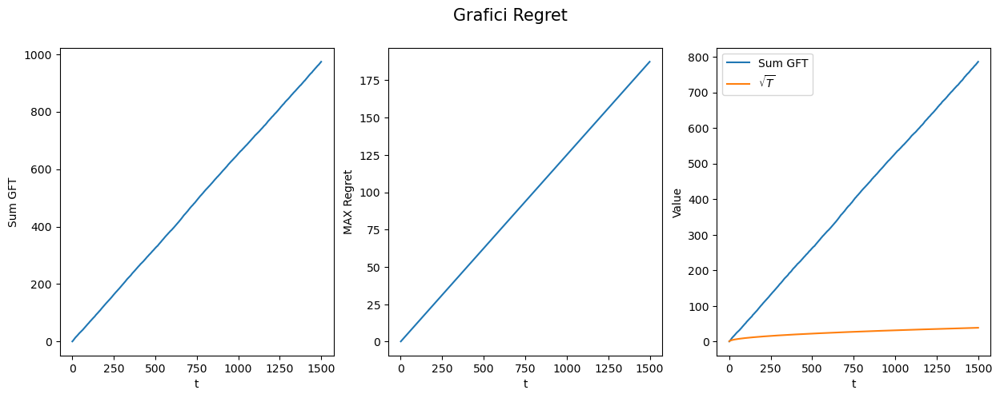

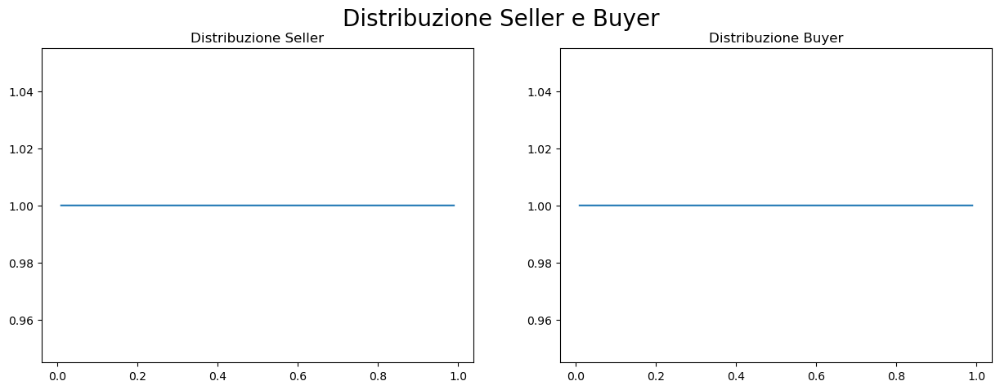

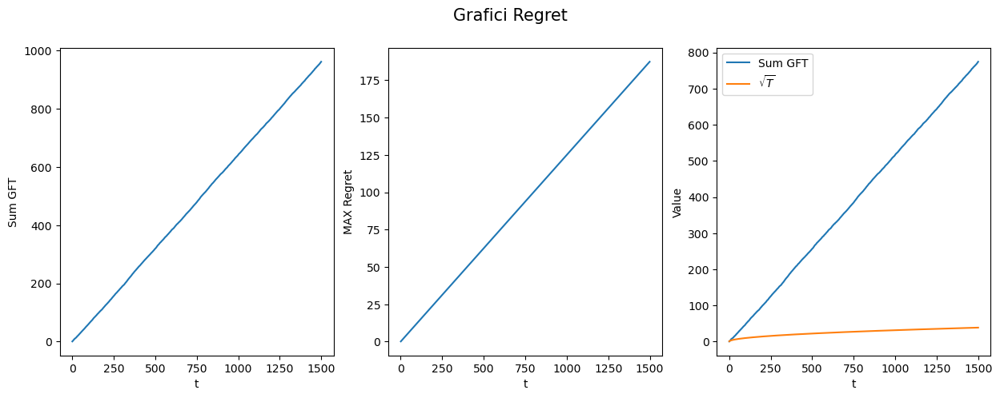

In [99]:
final_gft_results = check_stats_uniform_spaced_rangeval(n, num_round, num_cifre,rangeval)

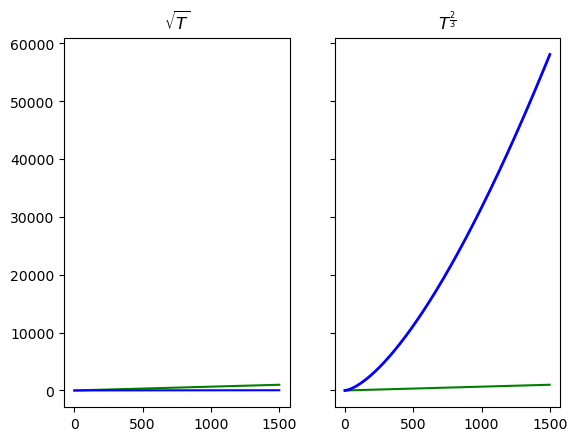

In [172]:
draw_results(final_gft_results, num_round)

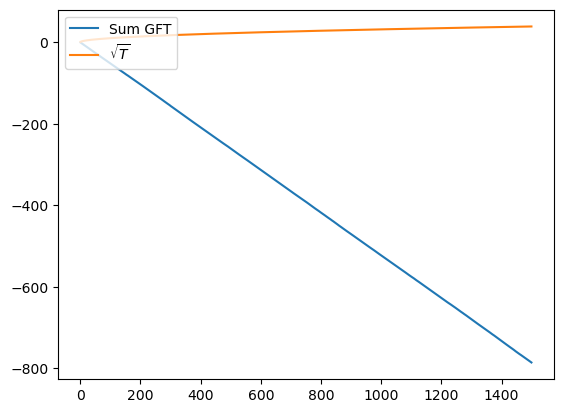

In [100]:
draw_median_gft_graph(final_gft_results, n, num_round)

### Variabile di Spaziata 2

In questo caso l'estremo max del primo intervallo e l'estremo min del secondo intervallo sono equidistanziati dal valore 0.5.


Turno:  1
Estremi Seller: [0,0.2]
Estremi Buyer: [0.8,1]

Round: # 1
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.05 
t-esimo Prezzo Buyer:  0.94
il massimo guadagno medio è:  0.89
t+1-esimo prezzo P: 0.5

Round: # 2
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.13 
t-esimo Prezzo Buyer:  0.99
il massimo guadagno medio è:  0.875
t+1-esimo prezzo P: 0.5

Round: # 3
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.16 
t-esimo Prezzo Buyer:  0.92
il massimo guadagno medio è:  0.8366666666666666
t+1-esimo prezzo P: 0.5

Round: # 4
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.15 
t-esimo Prezzo Buyer:  0.9
il massimo guadagno medio è:  0.815
t+1-esimo prezzo P: 0.5

Round: # 5
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.07 
t-esimo Prezzo Buyer:  0.96
il massimo guadagno medio è:  0.83
t+1-esimo prezzo P: 0.5

Round: # 6
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.12 
t-esimo Prezzo Buyer:  0.96
il massimo guadagno medio è:  0.8316666666666666
t+1-esimo prezzo P:

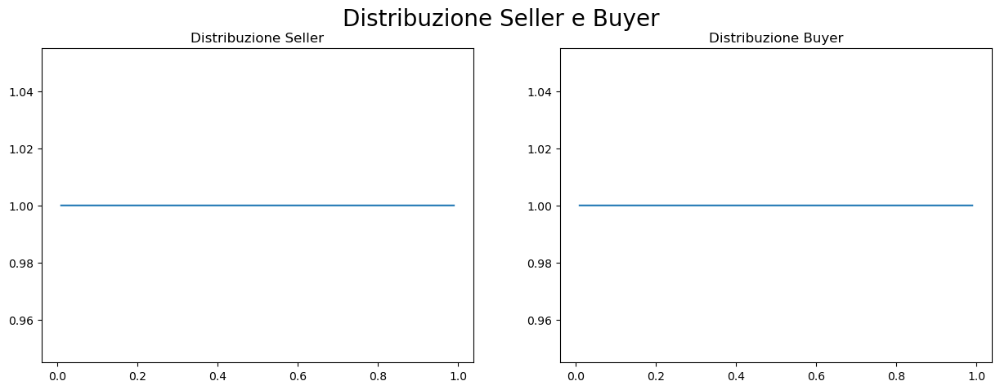

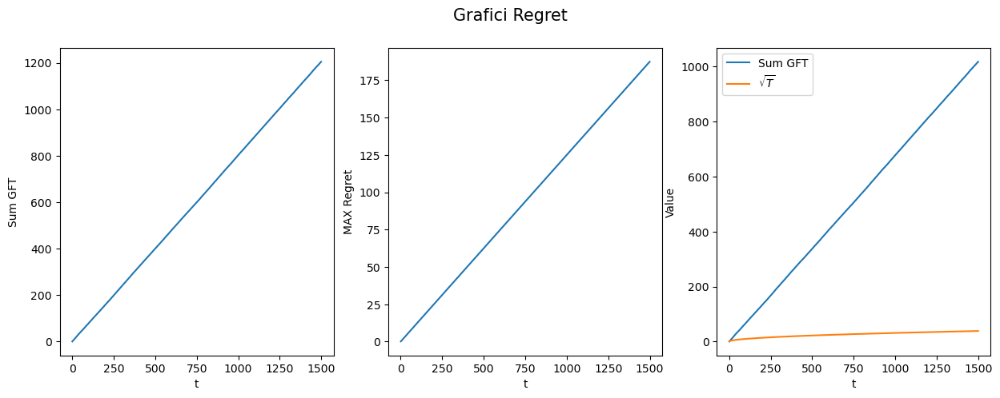

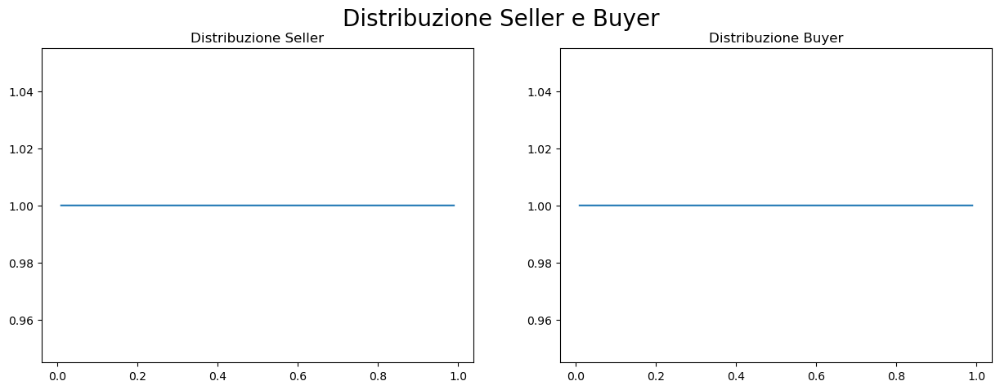

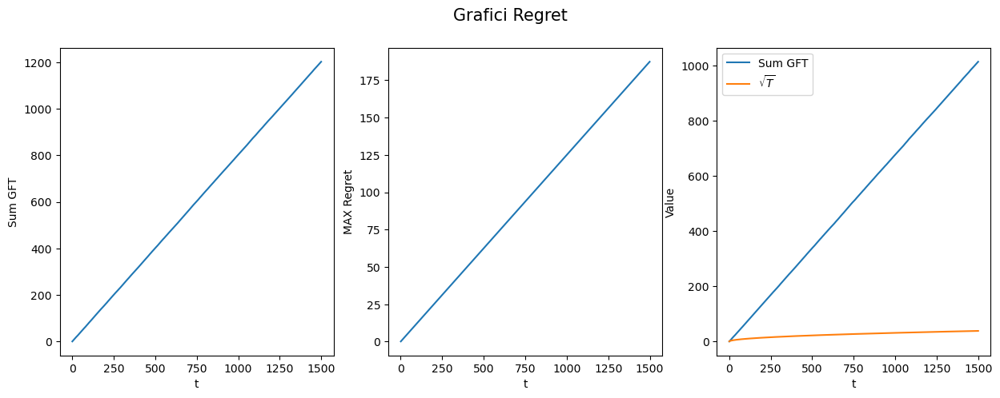

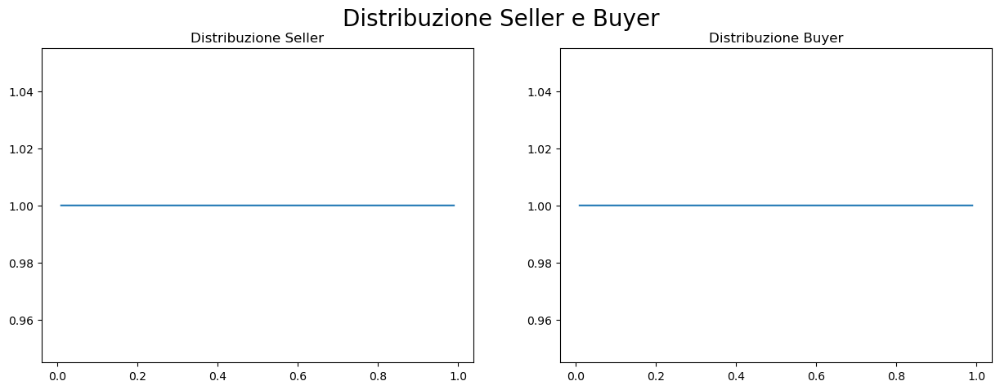

...

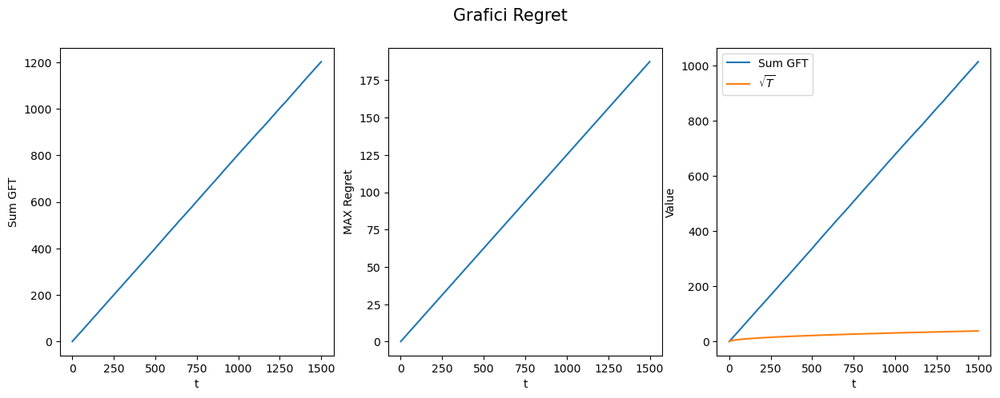

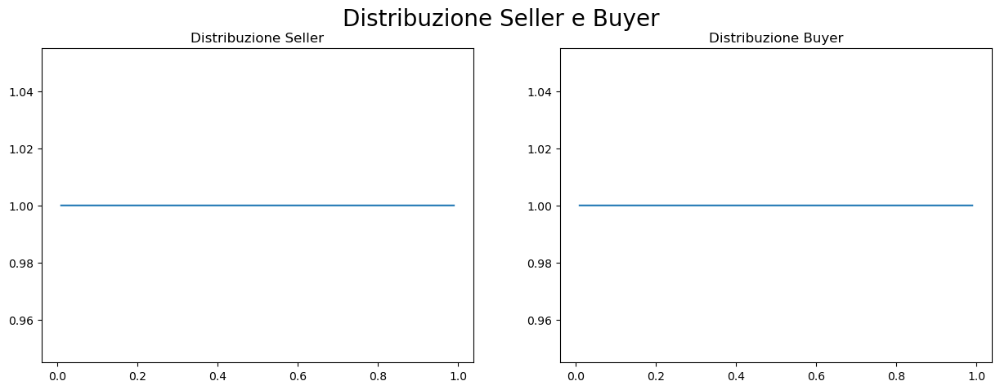

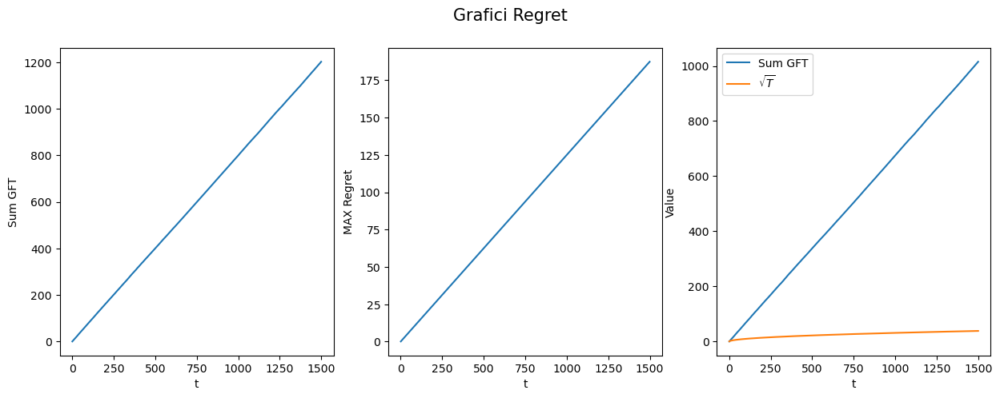

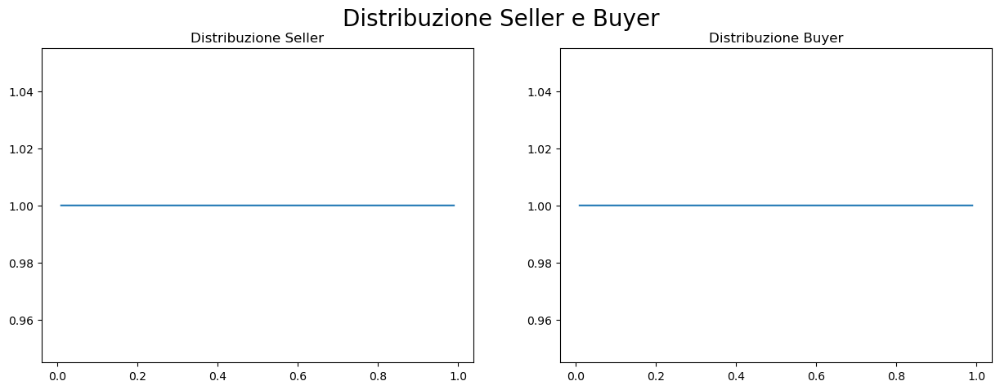

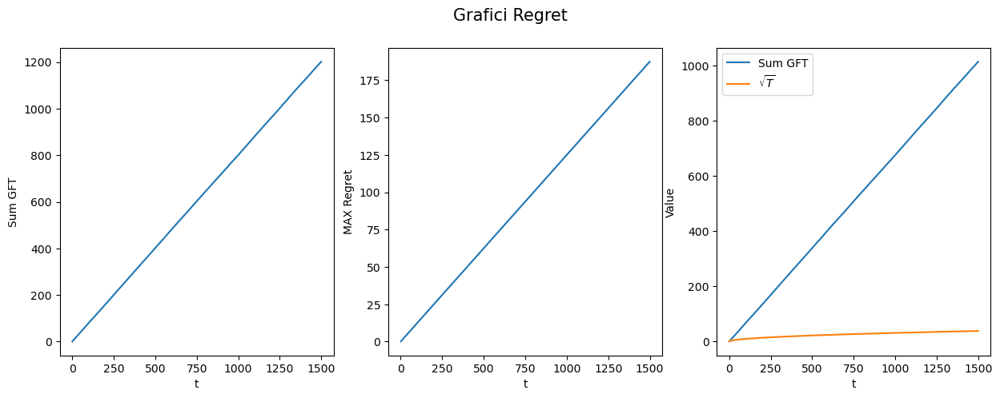

In [101]:
final_gft_results = check_stats_uniform_spaced_rangeval_from_center(n, num_round, num_cifre,rangeval)

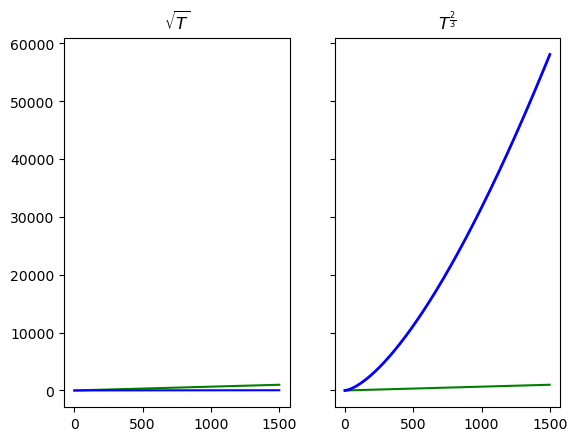

In [174]:
draw_results(final_gft_results, num_round)

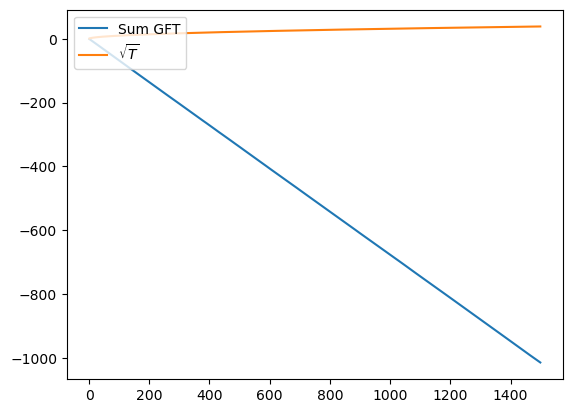

In [102]:
draw_median_gft_graph(final_gft_results, n, num_round)

### Variabile Spaziata 3

Come sopra ma il rangeval è casuale ad ogni round


Turno:  1
Estremi Seller: [0,0.5]
Estremi Buyer: [0.5,1]

Round: # 1
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.04 
t-esimo Prezzo Buyer:  0.52
il massimo guadagno medio è:  0.48
t+1-esimo prezzo P: 0.5

Round: # 2
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.1 
t-esimo Prezzo Buyer:  0.86
il massimo guadagno medio è:  0.62
t+1-esimo prezzo P: 0.5

Round: # 3
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.24 
t-esimo Prezzo Buyer:  0.87
il massimo guadagno medio è:  0.6233333333333333
t+1-esimo prezzo P: 0.5

Round: # 4
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.08 
t-esimo Prezzo Buyer:  0.68
il massimo guadagno medio è:  0.6175
t+1-esimo prezzo P: 0.5

Round: # 5
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.49 
t-esimo Prezzo Buyer:  0.5
il massimo guadagno medio è:  0.496
t+1-esimo prezzo P: 0.5

Round: # 6
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.1 
t-esimo Prezzo Buyer:  0.84
il massimo guadagno medio è:  0.5366666666666666
t+1-esimo prezzo P: 

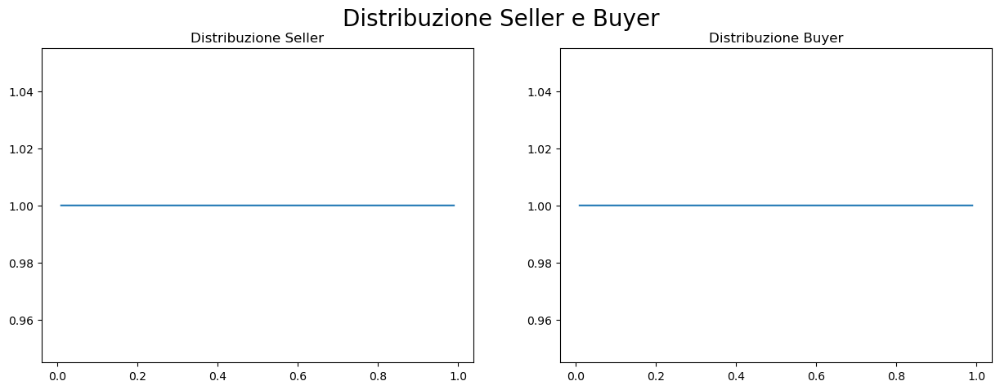

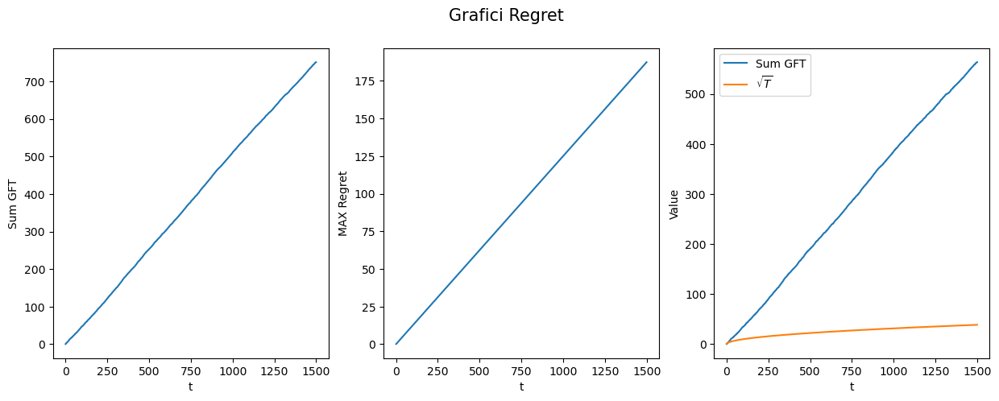

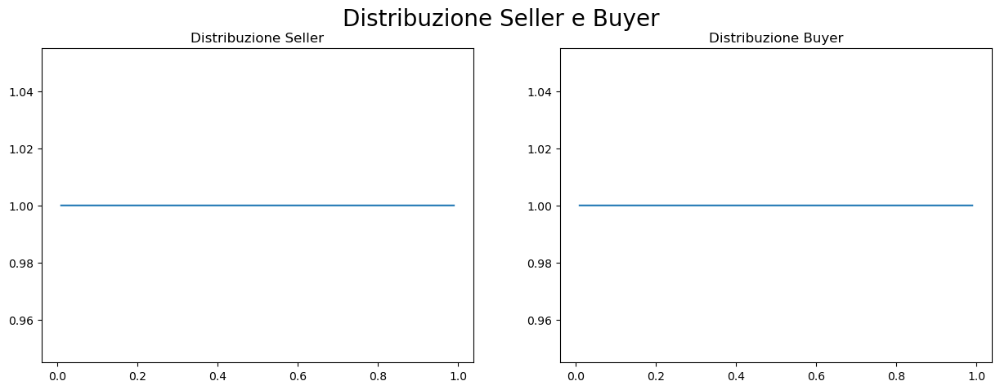

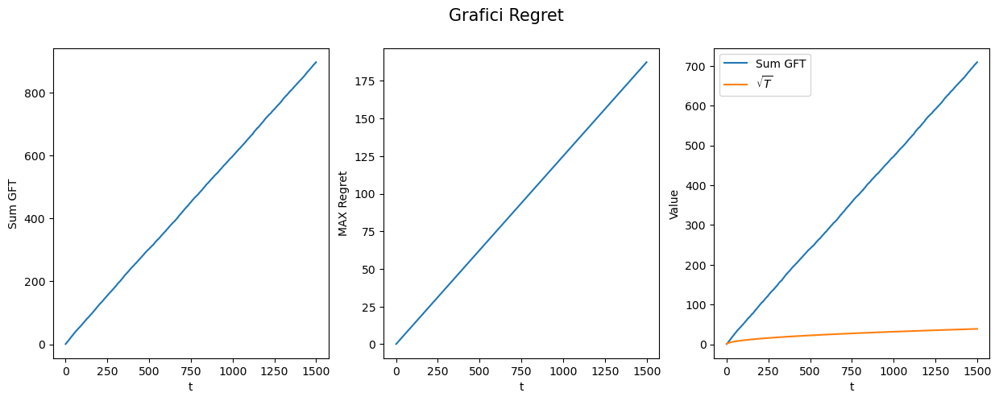

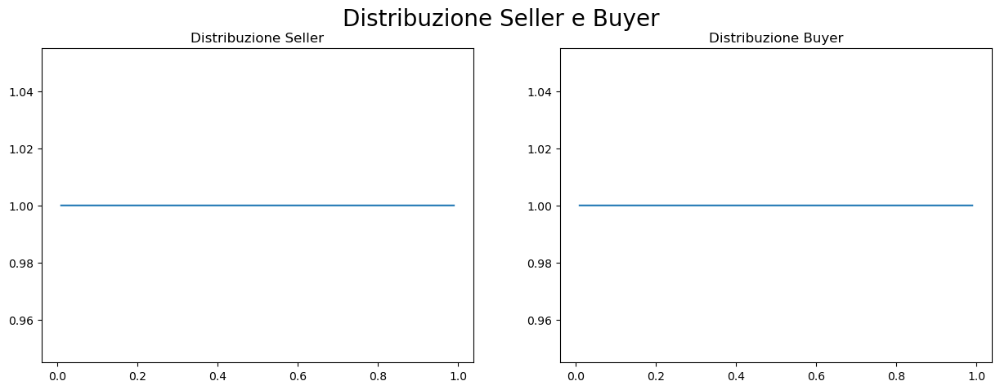

...

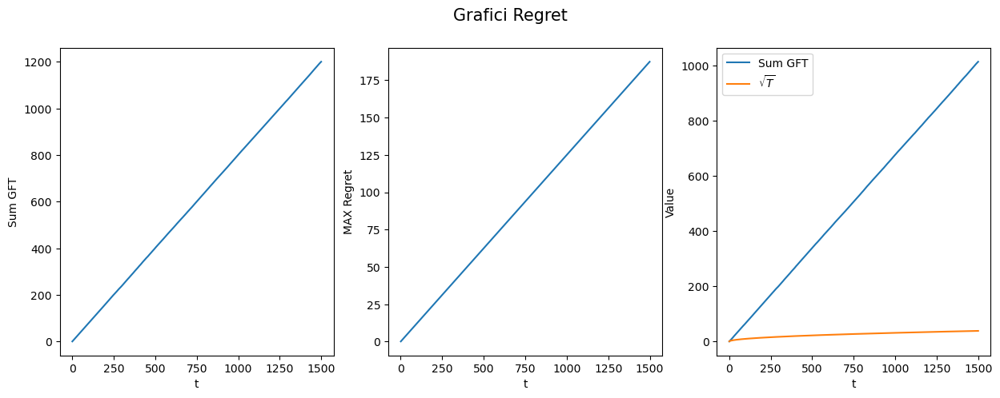

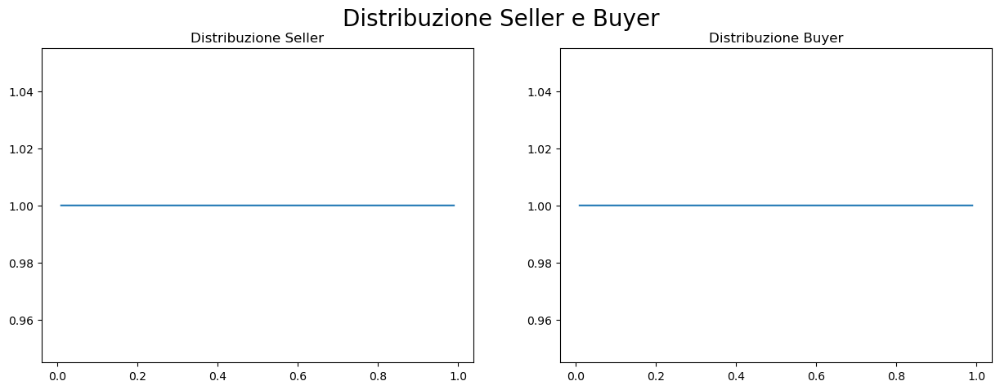

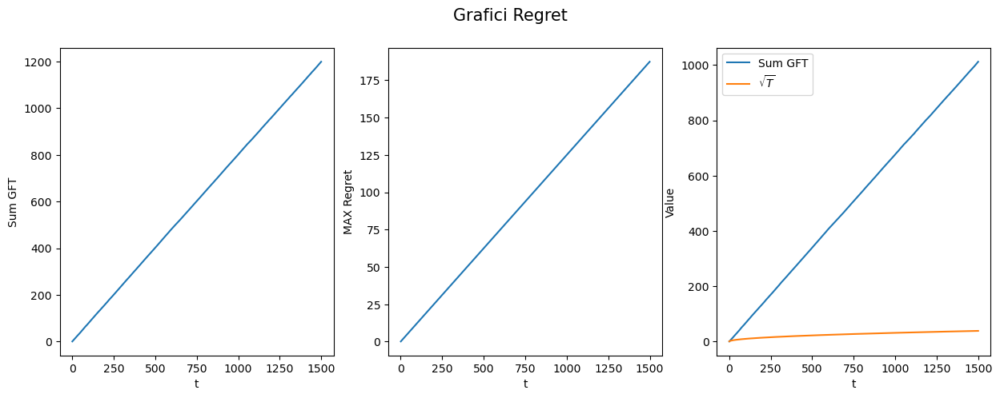

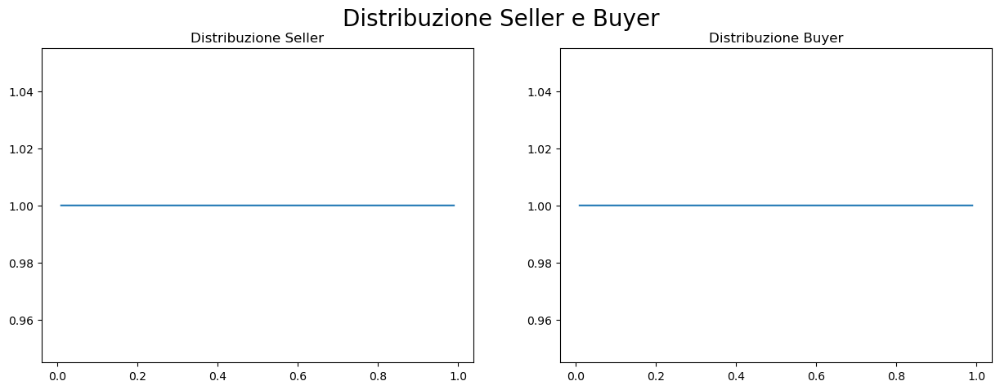

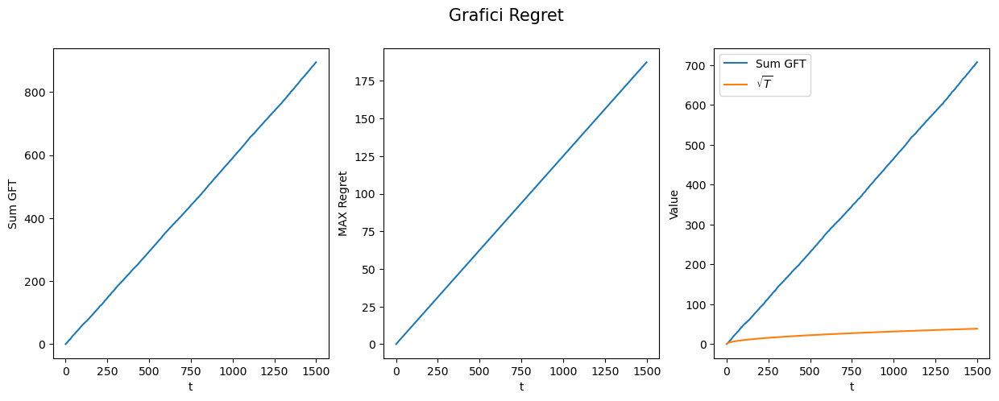

In [107]:
final_gft_results = check_stats_uniform_spaced_random_rangeval_from_center(n, num_round, num_cifre)

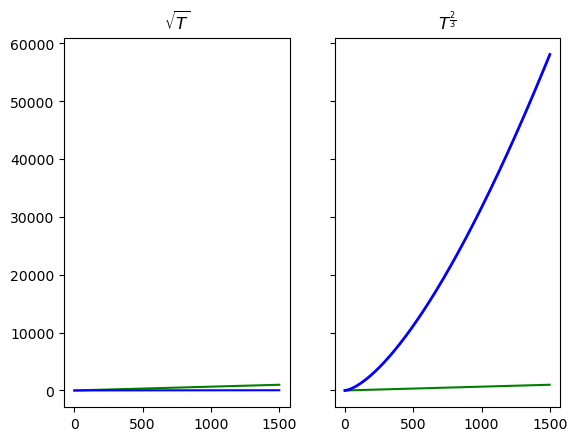

In [176]:
draw_results(final_gft_results, num_round)

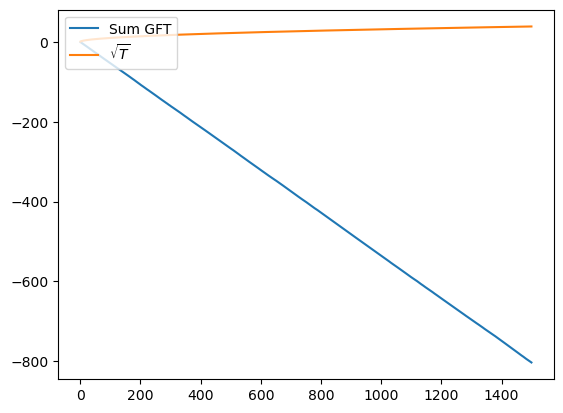

In [108]:
draw_median_gft_graph(final_gft_results, n, num_round)

### BETA

In [66]:
import numpy as np
from scipy.stats import beta
from scipy.integrate import dblquad

"""
  Calcola il valore atteso di una funzione integranda basata su distribuzioni beta.

  La funzione integranda viene calcolata in base ai parametri delle distribuzioni beta 
  del seller (S) e del buyer (B).

  Args:
      alpha_S: parametro alpha della distribuzione beta di vendita.
      beta_S: parametro beta della distribuzione beta di vendita.
      alpha_B: parametro alpha della distribuzione beta di acquisto.
      beta_B: parametro beta della distribuzione beta di acquisto.
      p: probabilità di acquisto.
      T: orizzonte temporale.

  Returns:
      Valore atteso moltiplicato per T.
  """

def expected_value_beta(alpha_S, beta_S, alpha_B, beta_B, p, T):
  
  # Funzione integranda in un punto (b,s)
    """
    Args:
        b: valore di acquisto casuale.
        s: valore di vendita casuale.
        alpha_S: parametro alpha della distribuzione beta di vendita.
        beta_S: parametro beta della distribuzione beta di vendita.
        alpha_B: parametro alpha della distribuzione beta di acquisto.
        beta_B: parametro beta della distribuzione beta di acquisto.

    Returns:
        Prodotto di (b - s) per le densità di probabilità beta di s e b.
    """
    def integrand(b, s, alpha_S, beta_S, alpha_B, beta_B):
        return (b - s) * beta.pdf(s, alpha_S, beta_S) * beta.pdf(b, alpha_B, beta_B)

  # Calcola il valore atteso
    """
    Utilizza la funzione dblquad per calcolare la doppia integrazione della funzione integranda.

    Args:
        p: probabilità di acquisto.
        alpha_S: parametro alpha della distribuzione beta di vendita.
        beta_S: parametro beta della distribuzione beta di vendita.
        alpha_B: parametro alpha della distribuzione beta di acquisto.
        beta_B: parametro beta della distribuzione beta di acquisto.

    Returns:
        Valore atteso.
    """
    def calculate_expected_value(p, alpha_S, beta_S, alpha_B, beta_B):
   
    # Limiti di integrazione
        outer_lower_limit = p  # Limite inferiore dell'integrale interno
        outer_upper_limit = 1  # Limite superiore dell'integrale interno

        inner_lower_limit = 0  # Limite inferiore dell'integrale esterno
        inner_upper_limit = p  # Limite superiore dell'integrale esterno

    # Argomenti per la funzione integranda
        args_integrand = (alpha_S, beta_S, alpha_B, beta_B)

    # Calcola la doppia integrazione con dblquad
        result, _ = dblquad(integrand, outer_lower_limit, outer_upper_limit, inner_lower_limit, inner_upper_limit, args=args_integrand)

    # Ottieni il valore atteso
        expected_value = result

    # Restituisci il valore atteso moltiplicato per T
        return expected_value * T

  # Calcola il valore atteso
    expected_value = calculate_expected_value(p, alpha_S, beta_S, alpha_B, beta_B)

  # Restituisci il valore atteso già moltiplicato per T
    return expected_value

valore alpha seller:  0.77
valore beta seller:  0.87
valore alpha buyer:  0.55
valore beta buyer:  0.97

Turno:  1
alpha seller:  0.77 	beta seller:  0.87 
alpha buyer:  0.55 	beta buyer:  0.97

Round: # 1
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.17 
t-esimo Prezzo Buyer:  0.96
il massimo guadagno medio è:  0.79
t+1-esimo prezzo P: 0.5

Round: # 2
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.99 
t-esimo Prezzo Buyer:  0.37
il massimo guadagno medio è:  0.395
t+1-esimo prezzo P: 0.5

Round: # 3
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.91 
t-esimo Prezzo Buyer:  0.09
il massimo guadagno medio è:  0.2633333333333333
t+1-esimo prezzo P: 0.5

Round: # 4
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.51 
t-esimo Prezzo Buyer:  0.04
il massimo guadagno medio è:  0.1975
t+1-esimo prezzo P: 0.5

Round: # 5
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.56 
t-esimo Prezzo Buyer:  0.26
il massimo guadagno medio è:  0.15800000000000003
t+1-esimo prezzo P: 0.5

Round: #

KeyboardInterrupt: 

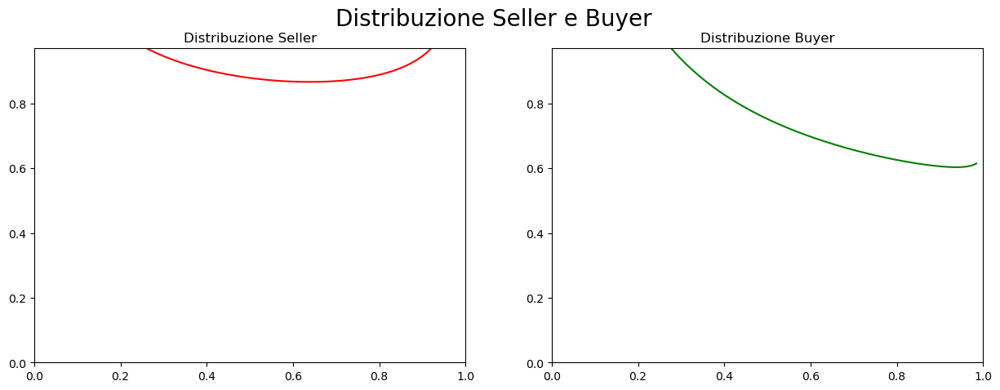

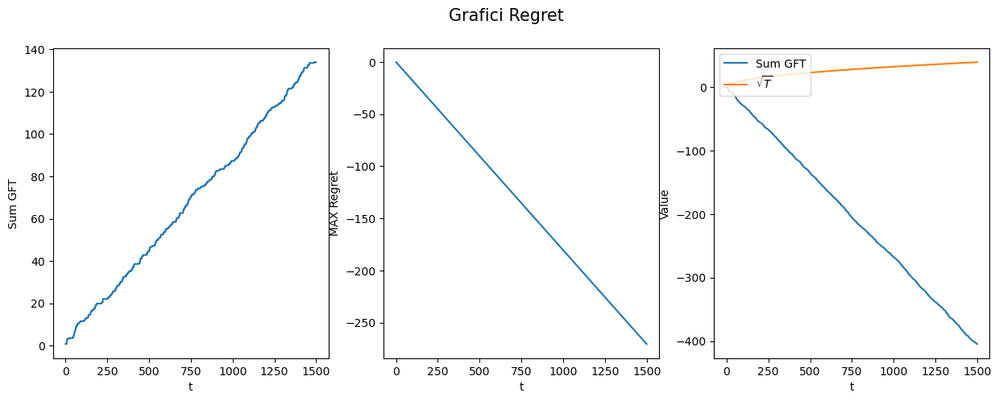

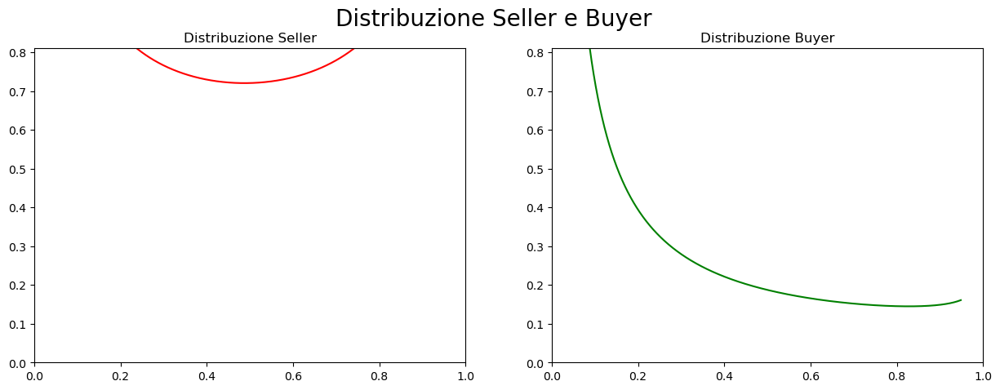

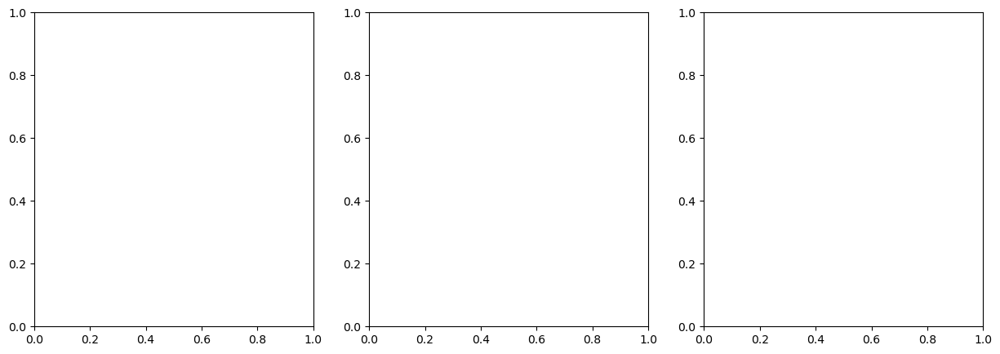


Round: # 1458
t-esimo Prezzo P:  0.431 
t-esimo Prezzo Seller:  0.714 
t-esimo Prezzo Buyer:  0.884
il massimo guadagno medio è:  0.04733813443072702
t+1-esimo prezzo P: 0.431

Round: # 1459
t-esimo Prezzo P:  0.431 
t-esimo Prezzo Seller:  0.147 
t-esimo Prezzo Buyer:  0.22
il massimo guadagno medio è:  0.04730568882796437
t+1-esimo prezzo P: 0.431

Round: # 1460
t-esimo Prezzo P:  0.431 
t-esimo Prezzo Seller:  0.77 
t-esimo Prezzo Buyer:  0.031
il massimo guadagno medio è:  0.04727328767123288
t+1-esimo prezzo P: 0.431

Round: # 1461
t-esimo Prezzo P:  0.431 
t-esimo Prezzo Seller:  0.937 
t-esimo Prezzo Buyer:  0.371
il massimo guadagno medio è:  0.04724093086926763
t+1-esimo prezzo P: 0.431

Round: # 1462
t-esimo Prezzo P:  0.431 
t-esimo Prezzo Seller:  0.293 
t-esimo Prezzo Buyer:  0.06
il massimo guadagno medio è:  0.04720861833105335
t+1-esimo prezzo P: 0.431

Round: # 1463
t-esimo Prezzo P:  0.431 
t-esimo Prezzo Seller:  0.901 
t-esimo Prezzo Buyer:  0.158
il massimo guadag

In [67]:
final_gft_results = check_stats_beta(n, num_round, num_cifre)

In [ ]:
draw_median_gft_graph(final_gft_results, n, num_round)

## DS $\pm \epsilon$

In [ ]:
final_gft_results = check_stats_DS(n, num_round, num_cifre)

<class 'numpy.ndarray'>

Turno:  1
Epsilon:  0.08010007426466503

Round: # 1
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.8516802726465929 
t-esimo Prezzo Buyer:  0.0
il massimo guadagno medio è:  0.0
t+1-esimo prezzo P: 0.5

Round: # 2
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.8516802726465929 
t-esimo Prezzo Buyer:  0.0
il massimo guadagno medio è:  0.0
t+1-esimo prezzo P: 0.5

Round: # 3
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.0 
t-esimo Prezzo Buyer:  1.0
il massimo guadagno medio è:  0.3333333333333333
t+1-esimo prezzo P: 0.5

Round: # 4
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.0 
t-esimo Prezzo Buyer:  1.0
il massimo guadagno medio è:  0.5
t+1-esimo prezzo P: 0.5

Round: # 5
t-esimo Prezzo P:  0.5 
t-esimo Prezzo Seller:  0.8516802726465929 
t-esimo Prezzo Buyer:  1.0
il massimo guadagno medio è:  0.43
t+1-esimo prezzo P: 0.8516802726465929

Round: # 6
t-esimo Prezzo P:  0.8516802726465929 
t-esimo Prezzo Seller:  0.0 
t-esimo Prezzo Buyer:  0.0
il

In [ ]:
draw_results(final_gft_results, num_round)

In [ ]:
draw_median_gft_graph(final_gft_results, n, num_round)